# Diagnostyka raka skóry z wykorzystaniem analizy obrazów dermatologicznych - porównanie modeli

Celem tego notatnika jest empiryczne i statysyczne porównanie skuteczności i stabilności modeli wytrenowanych w dwóch poprzednich notatnikach (DenseNet-121, DenseNet-121 + SVM, DenseNet-121 + Las losowy). Porównania dokonamy zarówno na zbiorze walidacyjnym i testowym (który przygotowaliśmy w `01_przygotowanie_danych.ipynb`).

## Konfiguracja środowiska

Instalujemy bibliotekę do testu Nemenyi'ego.

In [ ]:
!pip install -q scikit-posthocs

Importujemy potrzebne biblioteki.

In [ ]:
import os
import shutil
import glob
from tqdm import tqdm
from google.colab import drive, files
import kagglehub
import random
import time
import copy
import json
import joblib
import itertools
import numpy as np
import pandas as pd
from PIL import Image
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from sklearn.metrics import classification_report, matthews_corrcoef, accuracy_score, precision_score, recall_score, confusion_matrix
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import multiprocessing
from scipy.stats import shapiro, probplot, friedmanchisquare, levene
import scikit_posthocs as sp
import math

Definiujemy zmienne globalne.

In [ ]:
# parametry globalne
SEED = 42
BATCH_SIZE = 64                                                         # wielkość partii danych
NUM_WORKERS = min(4, multiprocessing.cpu_count())                       # liczba wątków procesora
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
NUM_CLASSES = 8                                                         # liczba klas
MODEL_NAME = 'DenseNet-121'                                             # nazwa modelu

# parametry transformacji obrazów
IMG_SIZE = 300                      # wymiar wejściowy obrazu
NORM_MEAN = [0.485, 0.456, 0.406]   # wartości średniej do normalizacji
NORM_STD = [0.229, 0.224, 0.225]    # wartości odchyleń do normalizacji

# parametry czyszczenia danych
VIGNETTE_THRESHOLD = 20      # próg czerni
EXTRA_CROP = 0.05            # margines dodatkowego przycięcia (5%)
MIN_FILL_RATIO = 0.95        # bezpiecznik dla zdjęć pełnokadrowych

# podział danych
CV_FOLDS = 5                 # liczba foldów walidacyjnych

# testy statystyczne
ALPHA = 0.05                # poziom istotności

Aby móc uzyskać dostęp do GPU w notatniku należy wybrać:

$\textbf{Środowisko wykonawcze} ⟶ \textbf{Zmień typ środowiska wykonwaczego} ⟶ \text{Wybieramy jedno z dostępnych GPU} ⟶ \textbf{Zapisz}$

Po takiej sekwencji operacji należy przepuścić kod notatnika od samego początku, gdyż zostanie przydzielona nowa sesja, a poprzednia zostanie usunięta.

Ustawiamy ziarno losości dla powtarzalności wyników.

In [ ]:
def set_seed(seed=42):
    """Ustawia ziarno losowości dla reprodukowalności wyników."""
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

In [ ]:
set_seed(SEED)

Dodatkowo konfigurujemy wygląd wykresów w całym notatniku.

In [ ]:
# bazowy styl seaborn
sns.set_theme(style="whitegrid", context="notebook", font_scale=1.1)

# konfiguracja parametrów matplotlib
plt.rcParams.update({
    # wymiary i jakość
    'figure.figsize': (10, 6),       # domyślny rozmiar
    'figure.dpi': 120,               # podgląd na ekranie
    'savefig.dpi': 300,              # jakość do druku
    'savefig.bbox': 'tight',         # automatyczne przycinanie marginesów przy zapisie
    'savefig.pad_inches': 0.1,       # mały bufor wokół przyciętego obrazka

    # tekst i czcionki
    'font.family': 'sans-serif',
    'font.sans-serif': ['Arial', 'DejaVu Sans', 'Liberation Sans'],
    'axes.labelsize': 15,            # rozmiar nazw osi
    'axes.titlesize': 20,            # rozmiar tytułu wykresu
    'xtick.labelsize': 11,           # rozmiar liczb na osi X
    'ytick.labelsize': 11,           # rozmiar liczb na osi Y
    'legend.fontsize': 11,           # rozmiar tekstu w legendzie

    # linie i siatka
    'lines.linewidth': 2.5,          # grubsze linie
    'lines.markersize': 8,           # nieco większe kropki/punkty
    'grid.color': '#f0f0f0',         # bardzo jasna szarość siatki
    'grid.linewidth': 1.0,
    'axes.axisbelow': True,          # siatka pod spodem, dane na wierzchu!

    # estetyka ramki
    'axes.spines.top': False,        # usuń górną ramkę
    'axes.spines.right': False,      # usuń prawą ramkę
    'axes.linewidth': 1.2,           # grubość osi X i Y
    'legend.frameon': True,          # włącz ramkę legendy
    'legend.framealpha': 0.95,       # białe tło legendy
    'legend.facecolor': 'white'
})

# wyostrzenie w Colab
%config InlineBackend.figure_format = 'retina'

Konfigurujemy wszelki potrzebne ścieżki.

In [ ]:
# montowanie Google Drive
drive.mount('/content/drive')

# podajemy nazwę głównego folderu projektu
PROJECT_FOLDER_NAME = 'Implementacja'
BASE_DIR = os.path.join('/content/drive/MyDrive/Diagnostyka raka skóry z wykorzystaniem analizy obrazów dermatologicznych', PROJECT_FOLDER_NAME)

# podajemy ścieżkę w Colabie do zapisania pobieranych danych
DATA_ROOT_DIR = '/content/ISIC2019'
IMG_DIR = os.path.join(DATA_ROOT_DIR, 'images')
PROCESSED_DIR = os.path.join(DATA_ROOT_DIR, 'images_processed')

# definijemy podfoldery
MODELS_DIR = os.path.join(BASE_DIR, 'Modele')
RESULTS_DIR = os.path.join(BASE_DIR, 'Wyniki')
DATA_DIR = os.path.join(BASE_DIR, 'Dane')

# tworzymy foldery na Google Drive (jeśli nie istnieją)
os.makedirs(MODELS_DIR, exist_ok=True)
os.makedirs(RESULTS_DIR, exist_ok=True)
os.makedirs(DATA_DIR, exist_ok=True)

print(f"Katalog roboczy projektu: {BASE_DIR}")
print(f"Dane będą zapisywane w: {DATA_ROOT_DIR}")

Mounted at /content/drive
Katalog roboczy projektu: /content/drive/MyDrive/Diagnostyka raka skóry z wykorzystaniem analizy obrazów dermatologicznych/Implementacja
Dane będą zapisywane w: /content/ISIC2019


### Konfiguracja Kaggle API

Kaggle API jest nam potrzebne do pobrania danych bezpośrednio do notatnika. Folder ZIP jest bardzo obszernym plikiem i ręczne wgrywanie go na Google Drive może zająć bardzo dużo czasu.

Kofigurujemy ścieżkę dla Kaggle API. Klucz będzie zapisywany bezpośrednio w folderze projektu.

In [ ]:
kaggle_key_drive_path = os.path.join(BASE_DIR, 'kaggle.json')

Tworzymy w Colabie folder na plik z Kaggle API.

In [ ]:
kaggle_sys_dir = '/root/.kaggle'
os.makedirs(kaggle_sys_dir, exist_ok=True)

Wprowadzamy Kaggle API. Klucz ten należy utworzyć indywidualnie dla każdego użytkownika notatników z implementacją pracy inżynierskie. Aby go zdobyć należy:
1. Zalogować się na swój profil na stronie Kaggle.
2. Wejście w ustawienia swojego profilu (kilkamy na swoje zdjęcie profilowe i wybieramy ,,Settings'').
3. W sekcji ,,API'' klikamy ,,Generate New Token'', następnie wprowadzamy nazwę tokenu i klikamy ,,Generate''.
4. Kopiujemy kod z okienka ,,API TOKEN''.
5. W dowolnym edytorze tekstu (np. Notatniku) wprowadzamy tekst o następującej strykturze
$$\{\text{"username":"nazwa_uzytkownika_kaggle","key":"skopiowane_kaggle_api"}\}$$
i zapisujemy plik jako ,,kaggle.json''.
W poniższej funkcji zostaniemy poproszeni o wgranie utworzonego pliku.


In [ ]:
# sprawdzamy czy klucz jest już na Drive
if not os.path.exists(kaggle_key_drive_path):
    print(f"UWAGA: Nie znaleziono pliku kaggle.json w lokalizacji: {kaggle_key_drive_path}")
    print("Proszę przesłać plik kaggle.json teraz (zostanie zapisany na Drive):")

    # przesyłamy plik kaggle.json
    uploaded = files.upload()

    for filename in uploaded.keys():
        if filename == 'kaggle.json':
            # zapisujemy trwale na Google Drive
            with open(kaggle_key_drive_path, 'wb') as f:
                f.write(uploaded[filename])
            print(f"Zapisano kaggle.json w: {kaggle_key_drive_path}")
        else:
            print(f"Pominięto plik: {filename} (oczekiwano kaggle.json)")

## Pobranie danych

Pobieramy, rozpakowujemy i porządkujemy zbiór ISIC2019. Nie pobieramy obrazów na dysk Google Drive, lecz do pamięci Google Colab. Pozwoli to na sprawniejsze wczytywanie plików w notatniku.

In [ ]:
if os.path.exists(kaggle_key_drive_path):
    # instalacja klucza w systemie
    shutil.copy(kaggle_key_drive_path, os.path.join(kaggle_sys_dir, 'kaggle.json'))
    os.chmod(os.path.join(kaggle_sys_dir, 'kaggle.json'), 600)
    print("Klucz Kaggle API skonfigurowany.")

    # POBIERANIE I PORZĄDKOWANIE DANYCH

    # sprawdzamy, czy folder ze zdjęciami już istnieje i jest pełny
    # (np. czy nie uruchamiamy komórki drugi raz w tej samej sesji)
    if not os.path.exists(IMG_DIR):
        print("\nPobieranie danych z Kaggle...")
        # pobieramy do folderu tymczasowego
        path = kagglehub.dataset_download("andrewmvd/isic-2019")
        print(f"Pobrano dane do folderu tymczasowego: {path}")

        # tworzymy docelowe foldery na obrazy
        os.makedirs(IMG_DIR, exist_ok=True)
        os.makedirs(PROCESSED_DIR, exist_ok=True)

        # przenosimy metadane w folderu z danymi w Colabie
        for csv_file in glob.glob(os.path.join(path, "*.csv")):
            shutil.copy(csv_file, DATA_ROOT_DIR)
            print(f"Przeniesiono: {os.path.basename(csv_file)}")

        # szukamy rekursywnie zdjęć we wszystkich podfolderach pobranych danych
        jpg_files = glob.glob(os.path.join(path, "**", "*.jpg"), recursive=True)

        print(f"Znaleziono {len(jpg_files)} zdjęć.")

        for file_path in tqdm(jpg_files, desc="Kopiowanie zdjęć", unit="plik"):
            # przenosimy plik do wspólnego folderu
            shutil.copy(file_path, os.path.join(IMG_DIR, os.path.basename(file_path)))
        print("Przeniesiono zdjęcia do folderu z danymi.")

        # weryfikujemy liczbę plików
        num_images = len(os.listdir(IMG_DIR))
        print(f"\nSUKCES: Dane gotowe w {DATA_ROOT_DIR}")
        print(f"Liczba zdjęć w {IMG_DIR}: {num_images}")

    else:
        print("Dane są już pobrane i uporządkowane.")
        print(f"Lokalizacja zdjęć: {IMG_DIR}")

else:
    print("BŁĄD: Brak pliku kaggle.json. Nie można pobrać danych.")

Klucz Kaggle API skonfigurowany.

Pobieranie danych z Kaggle...
Using Colab cache for faster access to the 'isic-2019' dataset.
Pobrano dane do folderu tymczasowego: /kaggle/input/isic-2019
Przeniesiono: ISIC_2019_Training_GroundTruth.csv
Przeniesiono: ISIC_2019_Training_Metadata.csv
Znaleziono 25331 zdjęć.


Kopiowanie zdjęć: 100%|██████████| 25331/25331 [04:13<00:00, 99.75plik/s] 

Przeniesiono zdjęcia do folderu z danymi.

SUKCES: Dane gotowe w /content/ISIC2019
Liczba zdjęć w /content/ISIC2019/images: 25331


## Przygotowanie danych

Wczytujemy metadane.

In [ ]:
metadata_processed_path = os.path.join(DATA_DIR, 'ISIC_metadata_processed.csv')
df_metadata = pd.read_csv(metadata_processed_path)
df_metadata.head()

,id_zdjecia,wiek,miejsce_zmiany,id_zmiany,plec,typ_zmiany,target,nazwa_pliku,typ_puli,nr_podzbioru
0,ISIC_0000000,55.0,Przód tułowia,ISIC_0000000,Kobieta,Znamię barwnikowe,6,ISIC_0000000.jpg,trening,3
1,ISIC_0000001,30.0,Przód tułowia,ISIC_0000001,Kobieta,Znamię barwnikowe,6,ISIC_0000001.jpg,trening,4
2,ISIC_0000002,60.0,Kończyna górna,ISIC_0000002,Kobieta,Czerniak,0,ISIC_0000002.jpg,trening,1
3,ISIC_0000003,30.0,Kończyna górna,ISIC_0000003,Mężczyzna,Znamię barwnikowe,6,ISIC_0000003.jpg,trening,2
4,ISIC_0000004,80.0,Plecy,ISIC_0000004,Mężczyzna,Czerniak,0,ISIC_0000004.jpg,trening,3


Wczytujemy i przycinamy zdjęcia.

In [ ]:
def crop_vignette(image_path, output_path, threshold=20, extra_crop_percent=0.05, min_fill_ratio=0.95):
    """
    Funkcja usuwająca czarne ramki (winiety) z obrazu z dodatkowym marginesem bezpieczeństwa
    oraz mechanizmem chroniącym zdjęcia pełnokadrowe.

    Parametry:
    - image_path: ścieżka do pliku wejściowego.
    - output_path: ścieżka zapisu pliku wynikowego.
    - threshold: próg jasności (0-255). Piksele ciemniejsze niż ta wartość są traktowane jako tło.
    - extra_crop_percent: ułamek (np. 0.05 = 5%), o jaki dodatkowo zmniejszamy ramkę z każdej strony,
      aby usunąć postrzępione krawędzie lub pozostałości winiety w rogach.
    - min_fill_ratio: współczynnik wypełnienia (zakres 0.0 - 1.0). Określa próg decyzyjny,
      czy zdjęcie w ogóle wymaga przycinania. Jeśli wykryty obszar treści zajmuje większą część
      zdjęcia niż ta wartość (np. > 95%), algorytm uznaje, że winieta nie występuje (lub jest pomijalna)
      i rezygnuje z przycinania, aby nie uszkodzić zmian skórnych dotykających krawędzi.
    """

    # wczytujemy obraz z dysku
    img = cv2.imread(image_path)

    # jeśli plik jest uszkodzony lub nie istnieje, przerywamy
    if img is None:
        return False, None

    # przekształcamy obraz do skali szarości i wyznaczmy obszar zdjęcia
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    h_img, w_img = gray.shape
    total_area = h_img * w_img

    # tworzymy maskę binarną:
    # - piksele > threshold (treść) dostają wartość 255 (biały)
    # - piksele <= threshold (tło/winieta) dostają wartość 0 (czarny)
    _, mask = cv2.threshold(gray, threshold, 255, cv2.THRESH_BINARY)

    # znajdujemy położenie treści
    # cv2.findNonZero zwraca listę współrzędnych wszystkich białych pikseli na masce
    coords = cv2.findNonZero(mask)

    # jeśli nie znaleziono żadnych jasnych punktów (zdjęcie jest całe czarne), kończymy
    if coords is None:
        return False, None

    # znajdujemy najmniejszy prostokąt (x, y, szerokość, wysokość), który obejmuje wszystkie jasne punkty
    x, y, w, h = cv2.boundingRect(coords)

    # obliczamy obszar czystego obrazu oraz współczynnik wypełnienia
    rect_area = w * h
    fill_ratio = rect_area / total_area

    # jeśli treść zajmuje prawie cały obraz (> 95%), to znaczy, że nie ma winiety,
    # albo są tylko mikro-paski, których nie warto ruszać, by nie uciąć zmiany
    if fill_ratio > min_fill_ratio:
        return False, None

    # ETAP PRZYCINANIA

    # obliczamy ile pikseli uciąć dodatkowo z każdej strony (5% szerokości/wysokości znalezionej ramki)
    margin_w = int(w * extra_crop_percent)
    margin_h = int(h * extra_crop_percent)

    # wyznaczamy nowe współrzędne ramki, zawężając ją do środka:
    # przesuwamy początek X w prawo i Y w dół
    new_x = x + margin_w
    new_y = y + margin_h

    # zmniejszamy szerokość i wysokość o marginesy z obu stron (lewo+prawo, góra+dół)
    new_w = w - (2 * margin_w)
    new_h = h - (2 * margin_h)

    # jeśli zdjęcie było bardzo małe lub margines był za duży i "zjadł" cały obraz (wymiar <= 0),
    # to cofamy się do wersji podstawowej (bez cięcia).
    if new_w <= 0 or new_h <= 0:
        new_x, new_y, new_w, new_h = x, y, w, h

    # sprawdzamy czy przycięcie jest konieczne
    # pobieramy oryginalne wymiary obrazu
    h_img, w_img = gray.shape

    # czy nowa, wyliczona ramka jest mniejsza niż oryginalny obraz?
    # jeśli tak, wykonujemy fizyczne cięcie obrazu
    if (new_w < w_img) or (new_h < h_img):
        # wycinanie fragmentu tablicy
        cropped_img = img[new_y:new_y+new_h, new_x:new_x+new_w]

        # zapisujemy wynik na dysk
        cv2.imwrite(output_path, cropped_img)

        # zwracamy sukces oraz informację, ile pikseli ucięto z każdej strony (góra, dół, lewo, prawo)
        return True, (new_y, h_img-(new_y+new_h), new_x, w_img-(new_x+new_w))

    # jeśli nie trzeba było ciąć (ramka pokrywa się z całym obrazem), zwracamy False
    return False, None

In [ ]:
# filtrujemy pliki, biorąc tylko te z rozszerzeniem .jpg lub .png
image_files = [f for f in os.listdir(IMG_DIR) if f.lower().endswith(('.jpg', '.png'))]

cropped_count = 0
copied_count = 0

print(f"Start: {len(image_files)} zdjęć. Dodatkowe cięcie: {EXTRA_CROP*100}%")

# pętla po wszystkich zdjęciach z użyciem paska postępu
for f in tqdm(image_files, desc="Przetwarzanie"):

    # tworzenie pełnych ścieżek
    src_path = os.path.join(IMG_DIR, f)
    dst_path = os.path.join(PROCESSED_DIR, f)

    # wywołujemy cięcie
    is_cropped, _ = crop_vignette(src_path, dst_path, threshold=VIGNETTE_THRESHOLD, extra_crop_percent=EXTRA_CROP, min_fill_ratio=MIN_FILL_RATIO)

    if is_cropped:
        # jeśli funkcja wykonała cięcie i zapisała plik -> zwiększ licznik
        cropped_count += 1
    else:
        # jeśli funkcja nie przycięła zdjęcia (zwróciła False) -> kopiujemy oryginał bez zmian
        shutil.copy(src_path, dst_path)
        copied_count += 1

print("\nZakończono przycinanie.")
print(f"Przycięto: {cropped_count}")
print(f"Skopiowano (bez zmian): {copied_count}")

Start: 25331 zdjęć. Dodatkowe cięcie: 5.0%


Przetwarzanie: 100%|██████████| 25331/25331 [04:54<00:00, 85.92it/s]


Zakończono przycinanie.
Przycięto: 2536
Skopiowano (bez zmian): 22795


Wczytaujemy wyniki treningów i predykcje wszystkich modeli.

In [ ]:
def load_results_and_predictions(results_dir):
    """
    Wczytuje i agreguje wyniki metryk oraz surowe predykcje dla wszystkich modeli
    (głębokich i hybrydowych) ze wszystkich foldów walidacji krzyżowej.

    Funkcja przetwarza pliki JSON z katalogu wyników, wyciągając najlepsze epoki
    dla sieci neuronowych oraz wyniki dla klasyfikatorów klasycznych, a następnie
    scala je w zbiorcze ramki danych.

    Args:
        results_dir (str): Ścieżka do katalogu zawierającego pliki JSON z wynikami.

    Returns:
        tuple: Krotka (all_metrics_df, all_preds_df), gdzie:
            - all_metrics_df (pd.DataFrame): Tabela zawierająca metryki (MCC, Dokładność,
              Czułość itp.) dla każdego modelu i foldu.
            - all_preds_df (pd.DataFrame): Tabela zawierająca pary (y_true, y_pred)
              dla każdej próbki testowej, z podziałem na model i fold.
    """
    densenet_results_list = []
    hybrid_results_list = []
    all_preds_list = []

    print(f"Rozpoczynam wczytywanie danych...")

    # wczytanie plików z wynikami DenseNet
    for fold_idx in range(CV_FOLDS):
        filename = f'{MODEL_NAME}_wyniki_treningu_fold_{fold_idx}.json'
        path = os.path.join(results_dir, filename)

        if os.path.exists(path):
            try:
                with open(path, 'r') as f:
                    data = json.load(f)

                # data to słownik z historią foldu: {'fold': 0, 'metryki': [...]}
                # szukamy najlepszej epoki według MCC
                best_epoch = max(data['metryki'], key=lambda x: x.get('mcc', -1))

                row = {
                    'Model': MODEL_NAME,
                    'Fold': fold_idx,
                    'Dokładność': best_epoch.get('dokładność'),
                    'MCC': best_epoch.get('mcc'),
                    'Czułość': best_epoch.get('czułość'),
                    'Specyficzność': best_epoch.get('specyficzność'),
                    'Precyzja': best_epoch.get('precyzja')
                }
                densenet_results_list.append(row)
            except Exception as e:
                print(f"[BŁĄD] Nie udało się wczytać {filename}: {e}")
        else:
            print(f"[OSTRZEŻENIE] Brak pliku metryk DenseNet: {filename}")

    print(f"-> Wczytano metryki {MODEL_NAME}.")

    # wczytujemy pliki z predykcjami DenseNet
    for fold_idx in range(CV_FOLDS):
        filename = f'{MODEL_NAME}_predykcje_fold_{fold_idx}.json'
        path = os.path.join(results_dir, filename)

        if os.path.exists(path):
            try:
                with open(path, 'r') as f:
                    data = json.load(f)

                # data = {'fold': 0, 'y_true': [...], 'y_pred': [...]}
                # tworzymy ramkę danych
                df = pd.DataFrame(data)
                df['Model'] = MODEL_NAME

                # normalizacja nazw kolumn
                if 'fold' in df.columns:
                    df = df.rename(columns={'fold': 'Fold'})
                else:
                    df['Fold'] = fold_idx

                # wybieramy kolumny
                df = df[['Model', 'Fold', 'y_true', 'y_pred']]
                all_preds_list.append(df)
            except Exception as e:
                print(f"[BŁĄD] Nie udało się wczytać {filename}: {e}")
        else:
            print(f"[OSTRZEŻENIE] Brak pliku predykcji DenseNet: {filename}")

    print(f"-> Wczytano predykcje {MODEL_NAME}.")

    # wczytyjemy pliku z wynikami modeli hybrydowych
    for fold_idx in range(CV_FOLDS):
        filename = f'wyniki_modeli_hybrydowych_fold_{fold_idx}.json'
        path = os.path.join(results_dir, filename)

        if os.path.exists(path):
            try:
                with open(path, 'r') as f:
                    data = json.load(f)

                # tworzymy ramkę danych
                df = pd.DataFrame(data)

                # mapowanie nazw
                rename_map = {
                    'model': 'Model',
                    'val_dokładność': 'Dokładność',
                    'val_mcc': 'MCC',
                    'val_czułość': 'Czułość',
                    'val_specyficzność': 'Specyficzność',
                    'val_precyzja': 'Precyzja'
                }
                df = df.rename(columns=rename_map)
                df['Fold'] = fold_idx

                wanted_cols = ['Model', 'Fold', 'Dokładność', 'MCC', 'Czułość', 'Specyficzność', 'Precyzja']
                # Wybieramy tylko te kolumny, które faktycznie istnieją w df
                cols_to_use = [c for c in wanted_cols if c in df.columns]

                hybrid_results_list.append(df[cols_to_use])
            except Exception as e:
                print(f"[BŁĄD] Nie udało się wczytać {filename}: {e}")
        else:
            print(f"[OSTRZEŻENIE] Brak pliku metryk hybrydowych: {filename}")

    print(f"-> Wczytano metryki modeli hybrydowych.")

    # wczytujemy pliki z predykcjami modeli hybrydowych
    for fold_idx in range(CV_FOLDS):
        filename = f'predykcje_modeli_hybrydowych_fold_{fold_idx}.json'
        path = os.path.join(results_dir, filename)

        if os.path.exists(path):
            try:
                # struktura: {'SVM': {'y_true': [], 'y_pred': []}, 'Las losowy': ...}
                # read_json z orient='index' stworzy wiersze SVM i Las losowy
                df = pd.read_json(path, orient='index')

                # rozwijamy
                df_exploded = df.explode(['y_true', 'y_pred'])

                # indeks to nazwa modelu (SVM, RF) - przenosimy do kolumny
                df_exploded['Model'] = df_exploded.index
                df_exploded['Fold'] = fold_idx

                # resetujemy indeks dla porządku
                df_exploded = df_exploded.reset_index(drop=True)

                all_preds_list.append(df_exploded)
            except Exception as e:
                print(f"[BŁĄD] Nie udało się wczytać {filename}: {e}")
        else:
            print(f"[OSTRZEŻENIE] Brak pliku predykcji hybrydowych: {filename}")

    print(f"-> Wczytano predykcje modeli hybrydowych.")

    # ŁĄCZENIE WYNIKÓW
    # metryki
    df_dense = pd.DataFrame(densenet_results_list)

    if hybrid_results_list:
        df_hybrid = pd.concat(hybrid_results_list, ignore_index=True)
        common_cols = df_dense.columns.intersection(df_hybrid.columns)
        all_metrics_df = pd.concat([df_dense[common_cols], df_hybrid[common_cols]], ignore_index=True)
    else:
        all_metrics_df = df_dense

    print(f"\n[SUKCES] Złączono metryki. Rozmiar: {all_metrics_df.shape}")

    # predykcje
    if all_preds_list:
        all_preds_df = pd.concat(all_preds_list, ignore_index=True)
        all_preds_df['y_true'] = all_preds_df['y_true'].astype(int)
        all_preds_df['y_pred'] = all_preds_df['y_pred'].astype(int)
        print(f"[SUKCES] Złączono predykcje. Rozmiar: {all_preds_df.shape}")
    else:
        all_preds_df = pd.DataFrame()
        print("[OSTRZEŻENIE] Brak predykcji!")

    return all_metrics_df, all_preds_df

In [ ]:
df_metrics, df_predictions = load_results_and_predictions(RESULTS_DIR)

Rozpoczynam wczytywanie danych...
-> Wczytano metryki DenseNet-121.
-> Wczytano predykcje DenseNet-121.
-> Wczytano metryki modeli hybrydowych.
-> Wczytano predykcje modeli hybrydowych.

[SUKCES] Złączono metryki. Rozmiar: (15, 7)
[SUKCES] Złączono predykcje. Rozmiar: (68394, 4)


Zobaczmy na tabele.

In [ ]:
df_metrics.head()

,Model,Fold,Dokładność,MCC,Czułość,Specyficzność,Precyzja
0,DenseNet-121,0,0.725000,0.592127,0.587823,0.951666,0.549146
1,DenseNet-121,1,0.712719,0.567499,0.579339,0.947319,0.548117
2,DenseNet-121,2,0.711842,0.572261,0.582969,0.949530,0.556951
3,DenseNet-121,3,0.713972,0.570937,0.574113,0.947723,0.538413
4,DenseNet-121,4,0.713095,0.574936,0.567366,0.949587,0.523890


In [ ]:
df_predictions.head()

,Model,Fold,y_true,y_pred
0,DenseNet-121,0,6,6
1,DenseNet-121,0,6,6
2,DenseNet-121,0,6,6
3,DenseNet-121,0,0,6
4,DenseNet-121,0,6,6


## Porównanie empiryczne modeli na zbiorze walidacyjnym

### Porównanie metryk

Przyjrzyjmy się wartościom metryk na zbiorze walidacyjnym. Zobaczmy wyniki dla poszczególnych foldów i modeli oraz przygotujmy średnie wyniki.

Tworzymy tabele dla poszczególnych

In [ ]:
# lista kolumn z metrykami
metric_cols = ['MCC', 'Czułość', 'Specyficzność', 'Dokładność', 'Precyzja']

# pobieramy nazwy modeli
models_unq = df_metrics['Model'].unique()

for model_name in models_unq:
    print(f"=== Szczegółowe wyniki dla modelu: {model_name} ===")

    # filtrujemy dane dla konkretnego modelu
    subset = df_metrics[df_metrics['Model'] == model_name][metric_cols + ['Fold']].copy()
    subset = subset.set_index('Fold')

    # obliczamy średnią o odchylenie
    means = subset.mean()
    stds = subset.std()

    # tworzymy tabelę do wyświetlenia
    df_display = subset.round(4).astype(str)

    # tworzymy wiersz podsumowaujący
    summary_row = []
    for col in metric_cols:
        mean_val = means[col]
        std_val = stds[col]
        summary_row.append(f"{mean_val:.4f} ± {std_val:.4f}")

    df_display.loc['Średnia'] = summary_row

    # wyświetlamy
    display(df_display)
    print("\n")

    # zapisujemy
    filename = f"wyniki_szczegolowe_{model_name.replace(' ', '_')}.csv"
    save_path = os.path.join(RESULTS_DIR, filename)
    df_display.to_csv(save_path, encoding='utf-8-sig')

=== Szczegółowe wyniki dla modelu: DenseNet-121 ===


,MCC,Czułość,Specyficzność,Dokładność,Precyzja
Fold,,,,,
0,0.5921,0.5878,0.9517,0.725,0.5491
1,0.5675,0.5793,0.9473,0.7127,0.5481
2,0.5723,0.583,0.9495,0.7118,0.557
3,0.5709,0.5741,0.9477,0.714,0.5384
4,0.5749,0.5674,0.9496,0.7131,0.5239
Średnia,0.5756 ± 0.0096,0.5783 ± 0.0079,0.9492 ± 0.0017,0.7153 ± 0.0055,0.5433 ± 0.0127




=== Szczegółowe wyniki dla modelu: SVM ===


,MCC,Czułość,Specyficzność,Dokładność,Precyzja
Fold,,,,,
0,0.602,0.5418,0.9534,0.7303,0.5919
1,0.6255,0.5742,0.9547,0.7507,0.6391
2,0.6251,0.569,0.9549,0.7493,0.6966
3,0.595,0.5399,0.9499,0.7309,0.6055
4,0.6255,0.5175,0.9561,0.7462,0.5924
Średnia,0.6146 ± 0.0149,0.5485 ± 0.0232,0.9538 ± 0.0024,0.7415 ± 0.0101,0.6251 ± 0.0443




=== Szczegółowe wyniki dla modelu: Las losowy ===


,MCC,Czułość,Specyficzność,Dokładność,Precyzja
Fold,,,,,
0,0.6143,0.5307,0.9537,0.7425,0.6283
1,0.6093,0.5478,0.9524,0.7401,0.6193
2,0.598,0.5456,0.9513,0.7325,0.6899
3,0.6059,0.5221,0.9527,0.7377,0.6213
4,0.6191,0.523,0.9551,0.7429,0.6125
Średnia,0.6093 ± 0.0081,0.5338 ± 0.0122,0.9530 ± 0.0014,0.7391 ± 0.0043,0.6343 ± 0.0316


Tworzymy również tabelę ze średnimi wynikami.

In [ ]:
# grupujemy wszystkie dane po modelu i liczymy średnią oraz odchylenie
agg_stats = df_metrics.groupby('Model')[metric_cols].agg(['mean', 'std'])

# tworzymy pustą ramkę na sformatowane wyniki
summary_table = pd.DataFrame(index=agg_stats.index)

# pętla po metrykach, aby skleić średnią i std w jeden napis
for metric in metric_cols:
    # wyciągamy kolumny mean i std
    means = agg_stats[(metric, 'mean')]
    stds = agg_stats[(metric, 'std')]

    # formatujemy każdą wartość w kolumnie
    # wynik to np. "0.9512 +/- 0.0120"
    summary_table[metric] = means.apply(lambda x: f"{x:.4f}") + " +/- " + stds.apply(lambda x: f"{x:.4f}")

# wyświetlamy gotową tabelę zbiorczą
display(summary_table)

# zapisujemy tabelę
summary_path = os.path.join(RESULTS_DIR, "wyniki_zbiorcze_metryk.csv")
summary_table.to_csv(summary_path, encoding='utf-8-sig')

,MCC,Czułość,Specyficzność,Dokładność,Precyzja
Model,,,,,
DenseNet-121,0.5756 +/- 0.0096,0.5783 +/- 0.0079,0.9492 +/- 0.0017,0.7153 +/- 0.0055,0.5433 +/- 0.0127
Las losowy,0.6093 +/- 0.0081,0.5338 +/- 0.0122,0.9530 +/- 0.0014,0.7391 +/- 0.0043,0.6343 +/- 0.0316
SVM,0.6146 +/- 0.0149,0.5485 +/- 0.0232,0.9538 +/- 0.0024,0.7415 +/- 0.0101,0.6251 +/- 0.0443


Zwizualizujmy te wyniki.

In [ ]:
def plot_model_comparison(df, metrics_cols, save_dir=RESULTS_DIR, filename='porownanie_skutecznosci.pdf'):


    # przekształcamy dane do dłuiego formatu.
    df_melted = df.melt(
        id_vars=['Model', 'Fold'],
        value_vars=metrics_cols,
        var_name='Metryka',
        value_name='Wartość'
    )

    # rysujemy wykres
    # errorbar='sd' oznacza, że czarne kreski to odchylenie standardowe
    ax = sns.barplot(
        data=df_melted,
        x='Metryka',
        y='Wartość',
        hue='Model',
        palette='viridis',
        errorbar='sd',     # rysuje odchylenie standardowe
        capsize=0.05,      # szerokość "czapeczek" na wąsach błędu
        edgecolor='black', # obramowanie słupków dla czytelności
        alpha=0.9
    )

    # kosmetyka wykresu
    plt.title('Porównanie średnich wartości metryk na zbiorze walidacyjnym', pad=20)
    plt.xlabel('Metryka', fontsize=12)
    plt.ylabel('Wartość', fontsize=12)

    # przesuwamy legednę poza wykres
    plt.legend(title='Model', bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

    # dostosowanie osi Y
    # jeśli wszystkie wyniki są > 0.8, to zaczynamy od najmniejszej wartości
    min_val = df_melted['Wartość'].min()
    plt.ylim(max(0, min_val - 0.1), 1.02) # Dolna granica dynamiczna, górna lekko ponad 1

    # dodajemy wartości średnich
    for container in ax.containers:
        ax.bar_label(container, fmt='%.3f', padding=10, fontsize=9, rotation=0)

    plt.tight_layout()
    if save_dir:
        save_path = os.path.join(save_dir, filename)
        plt.savefig(save_path)

    plt.show()

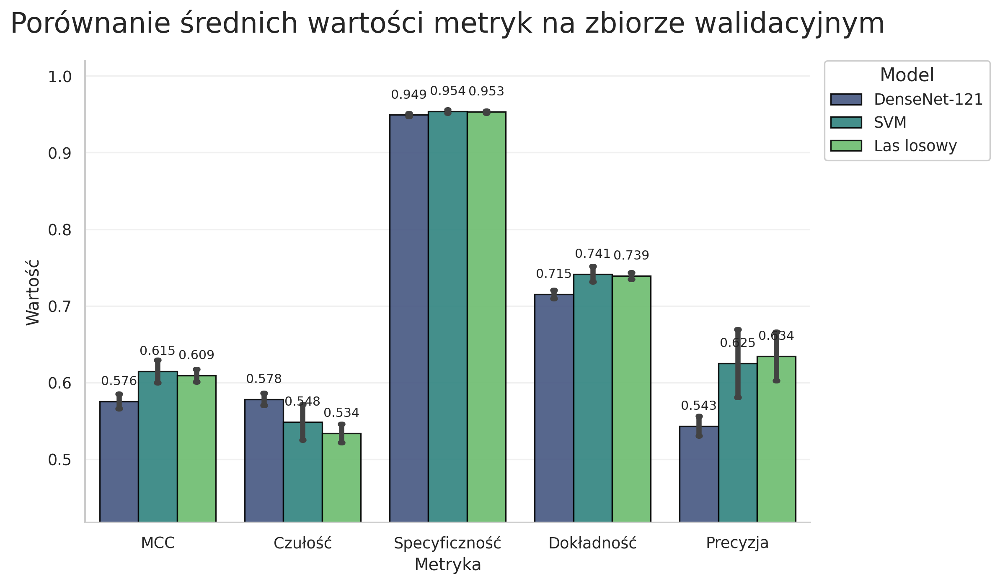

In [ ]:
plot_model_comparison(df_metrics, metric_cols, save_dir=RESULTS_DIR, filename='porownanie_skutecznosci.pdf')

Zwizualizujmy jeszcze stabliność modeli.

In [ ]:
def plot_stability_boxplot(df, metrics, save_dir=RESULTS_DIR, filename='analiza_stabilnosci_boxplot.pdf'):
    # obliczamy układ siatki
    n_metrics = len(metrics)
    n_cols = 2
    n_rows = math.ceil(n_metrics / n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 6 * n_rows))
    axes = axes.flatten()

    # kolory
    box_palette = 'Pastel1'
    point_color = '#333333'

    for i, metric in enumerate(metrics):
        ax = axes[i]

        # rysujemy wykres pudełkowy
        sns.boxplot(
            data=df,
            x='Model',
            y=metric,
            hue='Model',
            legend=False,
            ax=ax,
            palette=box_palette,
            showfliers=False,
            width=0.6,
            linewidth=1.5
        )

        # rysujemy punkty
        sns.swarmplot(
            data=df,
            x='Model',
            y=metric,
            color=point_color,
            size=7,
            alpha=0.7,
            ax=ax,
            dodge=False
        )

        # kosmetyka
        ax.set_title(metric, pad=15)
        ax.set_ylabel('Wartość metryki', fontsize=12)
        ax.set_xlabel('')

        #ax.grid(visible=True, axis='y', linestyle='--', alpha=0.7)
        #ax.grid(visible=False, axis='x')

        # zormatowanie osi Y i X
        ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3f'))
        #ax.tick_params(axis='x', labelsize=11)

    # ukrywamy puste wykresy
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle("Analiza stabilności modeli", fontsize=22, y=1.02)
    plt.tight_layout()

    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path)
    plt.show()

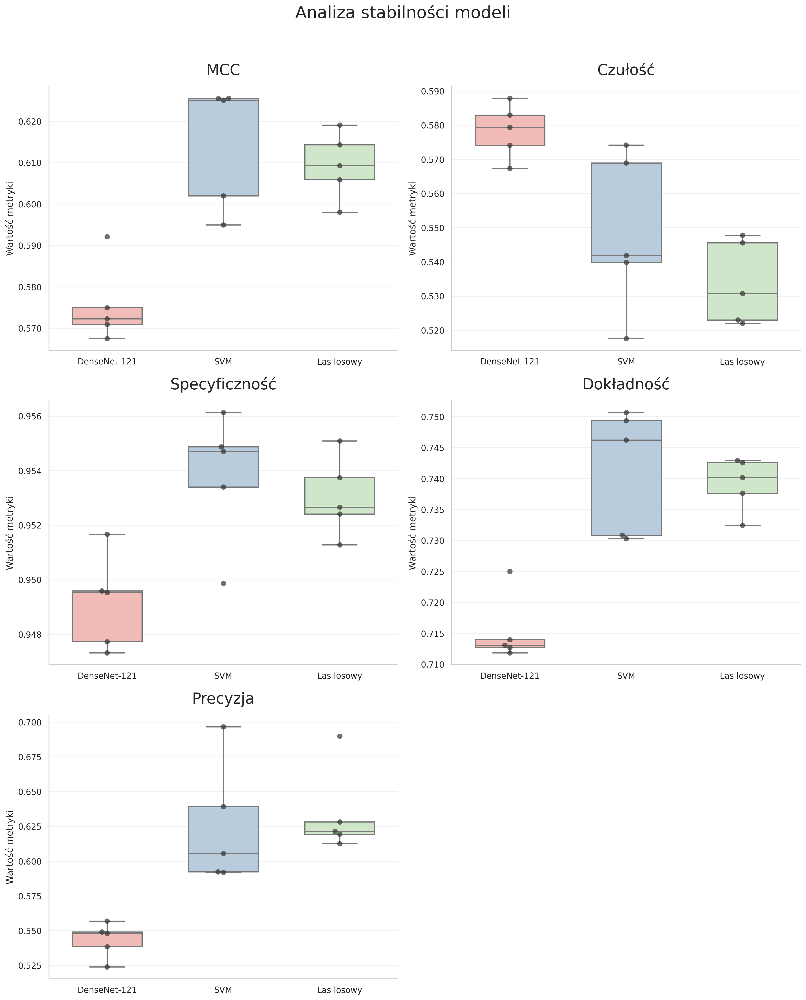

In [ ]:
plot_stability_boxplot(df_metrics, metric_cols)

### Porównanie predykcji

In [ ]:
def get_class_names(df):
    """
    Pobiera listę nazw klas posortowaną zgodnie z ich numerycznymi identyfikatorami.

    Funkcja tworzy mapowanie między kolumną 'target' (0, 1, 2...) a 'typ_zmiany' (nazwa choroby),
    gwarantując, że kolejność nazw na liście odpowiada kolejności wyjść modelu.
    Jest to niezbędne do poprawnego opisywania osi macierzy pomyłek.

    Args:
        df (pd.DataFrame): Ramka danych zawierająca kolumny 'target' (int) i 'typ_zmiany' (str).

    Returns:
        list: Lista nazw chorób (str), gdzie indeks elementu odpowiada wartości targetu (np. list[0] to nazwa dla target=0).
    """
    # sortujemy po target, żeby indeks 0 listy odpowiadał target=0
    sorted_classes = df[['target', 'typ_zmiany']].drop_duplicates().sort_values('target')
    return sorted_classes['typ_zmiany'].tolist()

In [ ]:
def plot_confusion_matrices(df_preds, classes=None, save_dir=RESULTS_DIR):
    models_unq = df_preds['Model'].unique()

    for model in models_unq:
        # tworzymy osobną figurę dla każdego modelu
        fig, ax = plt.subplots(figsize=(12, 10))

        # filtrujemy dane dla konkretnego modelu
        subset = df_preds[df_preds['Model'] == model]

        # wyznaczamy macierz pomyłek
        cm = confusion_matrix(subset['y_true'], subset['y_pred'])

        with np.errstate(divide='ignore', invalid='ignore'):
            cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            cm_norm = np.nan_to_num(cm_norm)

        # tworzymy etykiety: "Liczba\n(Procent%)"
        labels = [f"{val}\n({norm:.1%})" for val, norm in zip(cm.flatten(), cm_norm.flatten())]
        labels = np.asarray(labels).reshape(cm.shape)

        # rysowanie
        sns.heatmap(
            cm_norm,
            annot=labels,
            fmt='',
            cmap='Blues',
            cbar=False,
            square=True,
            xticklabels=classes if classes else "auto",
            yticklabels=classes if classes else "auto",
            ax=ax,
            vmin=0, vmax=1,
            annot_kws={"size": 14}
        )

        # tytuły i osie
        ax.set_title(f'{model}', pad=20)
        ax.set_xlabel('Przewidziana klasa')
        ax.set_ylabel('Prawdziwa klasa')

        # obracamy etykiety dla czytelności
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', rotation=0)
        ax.set_xticklabels(ax.get_xticklabels(), ha='right', rotation_mode='anchor')

        plt.tight_layout()

        # zapisujemy
        safe_model_name = str(model).replace(" ", "_")
        current_filename = f"macierz_pomylek_{safe_model_name}_walidacja.pdf"
        save_path = os.path.join(save_dir, current_filename)

        plt.savefig(save_path)
        plt.show()

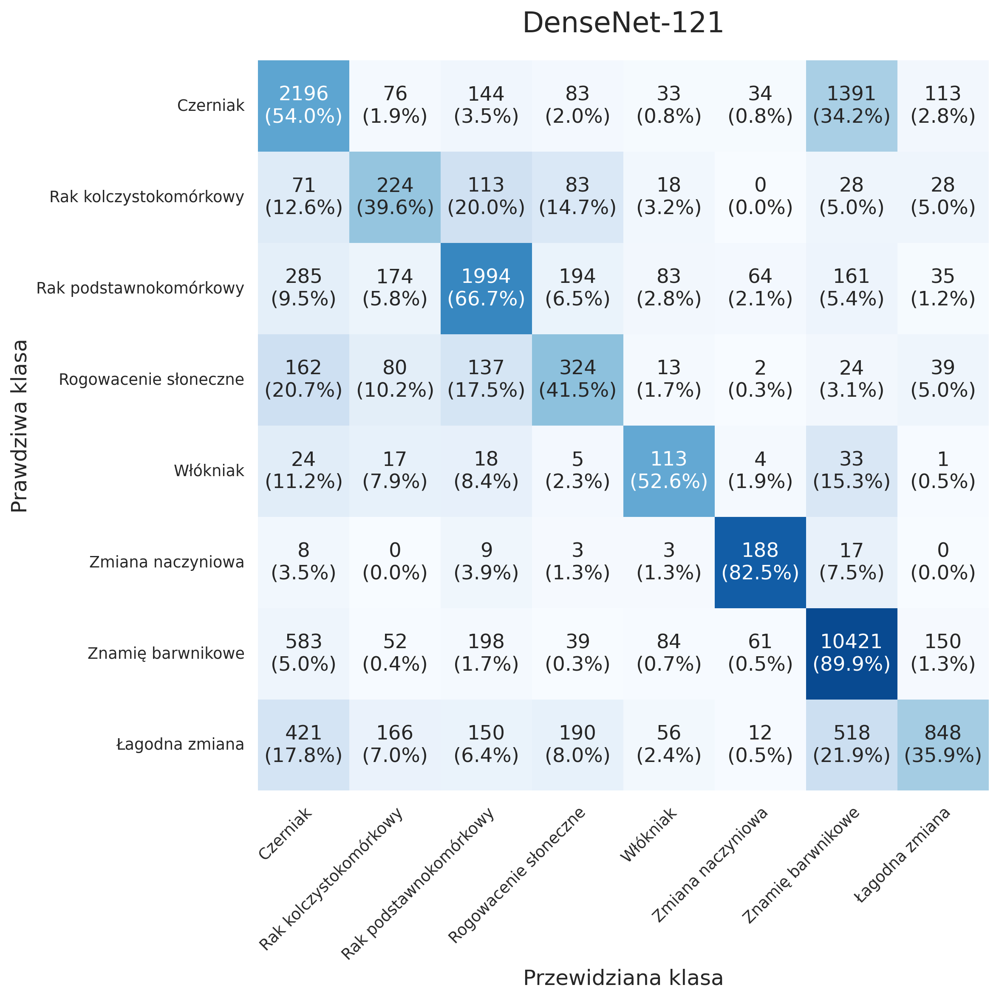

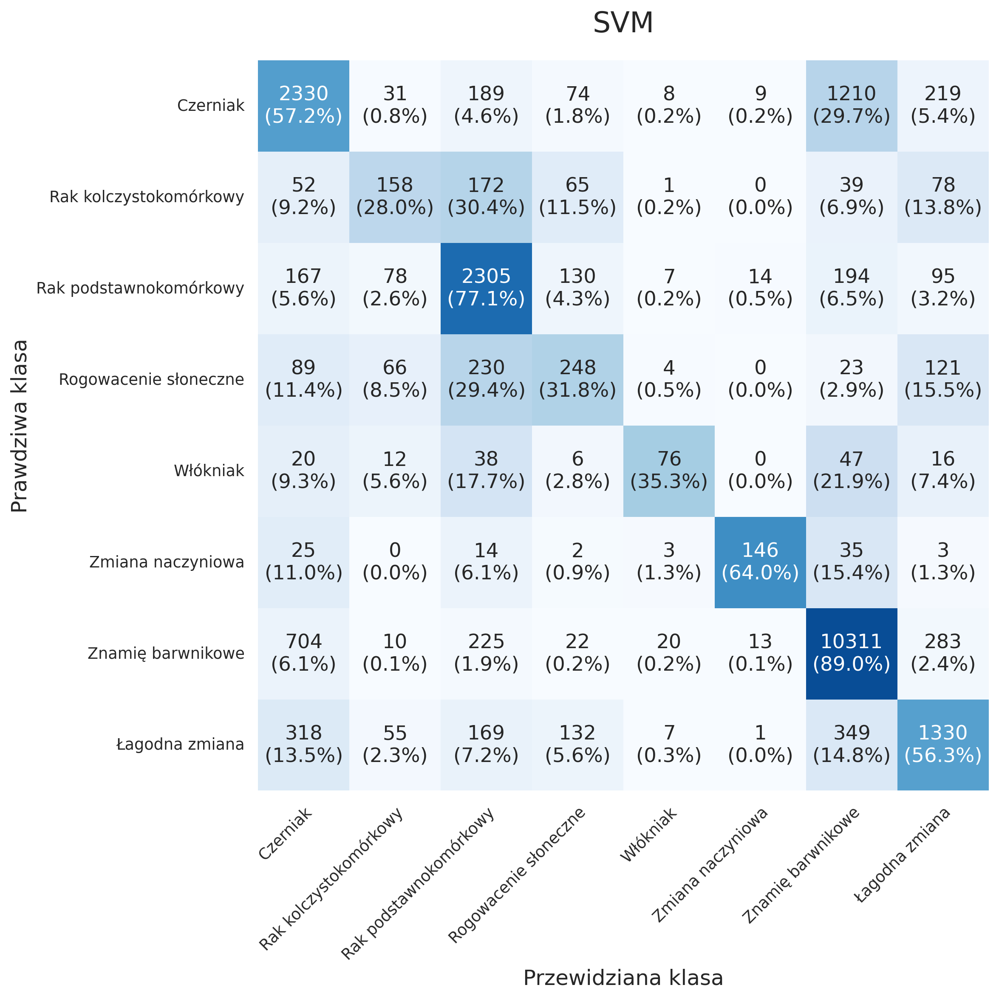

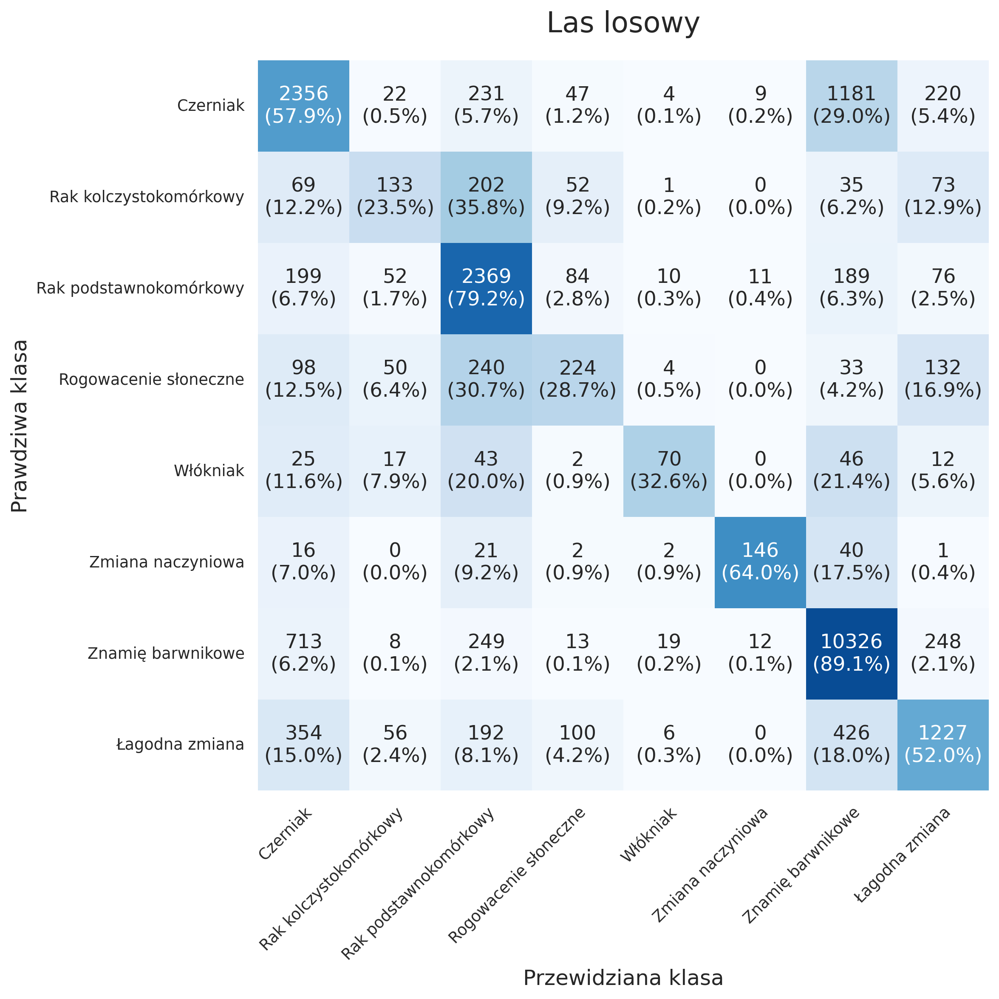

In [ ]:
class_names = get_class_names(df_metadata)
plot_confusion_matrices(df_predictions, classes=class_names)

In [ ]:
def plot_class_metrics_heatmaps(df_preds, classes, save_dir=RESULTS_DIR, filename="zestawienie_metryk_klas_mcc.pdf"):
    models_unq = df_preds['Model'].unique()

    # Słownik do przechowywania ramek danych dla każdej metryki
    metrics_data = {
        'Czułość': [],
        'Specyficzność': [],
        'Precyzja': [],
        'Współczynnik korelacji Mattewsa': [],
        'Dokładność': []
    }

    # obliczenia
    for model in models_unq:
        subset = df_preds[df_preds['Model'] == model]
        cm = confusion_matrix(subset['y_true'], subset['y_pred'])

        # obliczenia One-vs-Rest dla każdej klasy
        TP = cm.diagonal()
        FP = cm.sum(axis=0) - TP
        FN = cm.sum(axis=1) - TP
        TN = cm.sum() - (TP + FP + FN)

        with np.errstate(divide='ignore', invalid='ignore'):
            # czułość (TP / P)
            sens = np.nan_to_num(TP / (TP + FN))
            # specyficzność (TN / N)
            spec = np.nan_to_num(TN / (TN + FP))
            # precyzja (TP / (TP+FP))
            prec = np.nan_to_num(TP / (TP + FP))
            # dokładność dla danej klasy (TP+TN) / Total
            acc = np.nan_to_num((TP + TN) / cm.sum())

            # mcc
            numerator = (TP * TN) - (FP * FN)
            denominator = np.sqrt((TP + FP) * (TP + FN) * (TN + FP) * (TN + FN))
            mcc = np.nan_to_num(numerator / denominator)

        # dodajemy wyniki tego modelu do list
        metrics_data['Czułość'].append(pd.Series(sens, index=classes, name=model))
        metrics_data['Specyficzność'].append(pd.Series(spec, index=classes, name=model))
        metrics_data['Precyzja'].append(pd.Series(prec, index=classes, name=model))
        metrics_data['Współczynnik korelacji Mattewsa'].append(pd.Series(mcc, index=classes, name=model))
        metrics_data['Dokładność'].append(pd.Series(acc, index=classes, name=model))

    # rysowanie
    n_metrics = len(metrics_data)
    fig, axes = plt.subplots(n_metrics, 1, figsize=(14, 7 * n_metrics))

    for i, (metric_name, data_list) in enumerate(metrics_data.items()):
        ax = axes[i]

        # tworzymy DataFrame z listy serii
        df_metric = pd.DataFrame(data_list)

        # ustawienia kolorów i zakresu
        # dla MCC zakres to teoretycznie -1 do 1, ale w praktyce rzadko spada poniżej 0 przy dobrym modelu.
        # możemy ustawić vmin=0 dla spójności wizualnej, lub -1 jeśli chcesz widzieć ujemne korelacje.
        # tutaj zostawiam vmin=0 dla czystości wizualnej (ujemne MCC to i tak "czerwony" alarm).
        heatmap_vmin = 0

        sns.heatmap(
            df_metric,
            annot=True,
            fmt=".3f" if metric_name == 'MCC' else ".1%",
            cmap="RdYlGn",
            vmin=heatmap_vmin, vmax=1,
            linewidths=.5,
            ax=ax,
            cbar_kws={'label': metric_name}
        )

        ax.set_title(f'{metric_name} - porównanie per klasa', pad=15)
        ax.set_ylabel('Model', fontsize=14)

        # oś X podpisujemy na każdym wykresie dla wygody czytelnika
        ax.set_xlabel('')
        ax.set_xticklabels(classes, rotation=45, ha='right', rotation_mode='anchor')

        ax.set_yticklabels(ax.get_yticklabels(), rotation=0)

    plt.suptitle('Szczegółowa analiza skuteczności modeli', fontsize=22, y=1.01)
    plt.tight_layout()

    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path)
    plt.show()

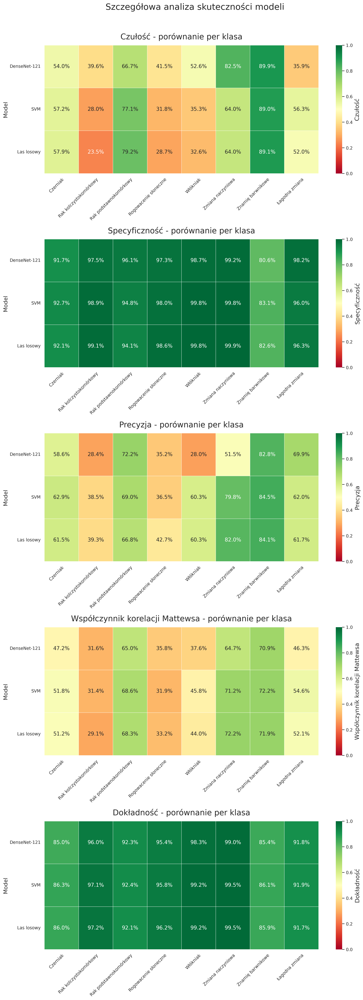

In [ ]:
plot_class_metrics_heatmaps(df_predictions, classes=class_names)

In [ ]:
per_class_data = []

class_names = get_class_names(df_metadata)
folds = df_predictions['Fold'].unique()

for model in models_unq:
    for fold in folds:
        subset = df_predictions[(df_predictions['Model'] == model) & (df_predictions['Fold'] == fold)]

        if subset.empty:
            continue

        y_true = subset['y_true']
        y_pred = subset['y_pred']

        # obliczamy Macierz Pomyłek dla danego foldu
        # labels=range(8) zapewnia, że macierz ma zawsze wymiar 8x8, nawet jak jakiejś klasy brakuje w foldzie
        cm = confusion_matrix(y_true, y_pred, labels=range(len(class_names)))

        # liczymy metryki dla każdej klasy osobno (One-vs-Rest)
        for class_idx, class_name in enumerate(class_names):
            # TP: Kiedy to była ta klasa i przewidzieliśmy tę klasę
            TP = cm[class_idx, class_idx]

            # FP: Przewidzieliśmy tę klasę, a to było co innego (suma kolumny - TP)
            FP = cm[:, class_idx].sum() - TP

            # FN: To była ta klasa, a przewidzieliśmy co innego (suma wiersza - TP)
            FN = cm[class_idx, :].sum() - TP

            # TN: Wszystko inne (Suma całej macierzy - (TP + FP + FN))
            TN = cm.sum() - (TP + FP + FN)

            # Obliczenia metryk (z zabezpieczeniem przed dzieleniem przez zero)
            accuracy_cls = (TP + TN) / (TP + TN + FP + FN) # Dokładność dla tej konkretnej klasy
            sensitivity = TP / (TP + FN) if (TP + FN) > 0 else 0.0 # Czułość (Recall)
            specificity = TN / (TN + FP) if (TN + FP) > 0 else 0.0 # Specyficzność
            precision = TP / (TP + FP) if (TP + FP) > 0 else 0.0   # Precyzja
            mcc_numerator = (TP * TN) - (FP * FN)
            mcc_denominator = np.sqrt((TP + FP) * (TP + FN) * (TN + FP) * (TN + FN))

            if mcc_denominator == 0:
                mcc = 0.0
            else:
                mcc = mcc_numerator / mcc_denominator

            per_class_data.append({
                'Model': model,
                'Fold': fold,
                'Klasa_Nazwa': class_name,
                'MCC': mcc,               # <--- Nowa kolumna
                'Czułość': sensitivity,
                'Specyficzność': specificity,
                'Precyzja': precision,
                'Dokładność_Klasy': accuracy_cls,
                'Liczebność': TP + FN
            })


In [ ]:
df_class_raw = pd.DataFrame(per_class_data)

# zapis surowych danych
raw_csv_path = os.path.join(RESULTS_DIR, "analiza_klas_surowa.csv")
df_class_raw.to_csv(raw_csv_path, encoding='utf-8-sig', index=False)

# dodajemy MCC do listy metryk do agregacji
metrics_to_agg = ['MCC', 'Czułość', 'Specyficzność', 'Precyzja', 'Dokładność_Klasy']

agg_class = df_class_raw.groupby(['Model', 'Klasa_Nazwa'])[metrics_to_agg].agg(['mean', 'std'])

summary_table = pd.DataFrame(index=agg_class.index)

for metric in metrics_to_agg:
    summary_table[metric] = (
        agg_class[(metric, 'mean')].apply(lambda x: f"{x:.3f}") +
        " +/- " +
        agg_class[(metric, 'std')].apply(lambda x: f"{x:.3f}")
    )

display(summary_table)

summary_csv_path = os.path.join(RESULTS_DIR, "analiza_predykcji_klas.csv")
summary_table.to_csv(summary_csv_path, encoding='utf-8-sig')

MCC          Czułość  \
Model        Klasa_Nazwa                                                
DenseNet-121 Czerniak                0.475 +/- 0.017  0.540 +/- 0.058   
             Rak kolczystokomórkowy  0.316 +/- 0.013  0.396 +/- 0.060   
             Rak podstawnokomórkowy  0.650 +/- 0.022  0.667 +/- 0.055   
             Rogowacenie słoneczne   0.361 +/- 0.052  0.415 +/- 0.084   
             Włókniak                0.390 +/- 0.049  0.526 +/- 0.088   
             Zmiana naczyniowa       0.657 +/- 0.103  0.825 +/- 0.081   
             Znamię barwnikowe       0.710 +/- 0.008  0.899 +/- 0.018   
             Łagodna zmiana          0.464 +/- 0.016  0.359 +/- 0.036   
Las losowy   Czerniak                0.512 +/- 0.032  0.579 +/- 0.027   
             Rak kolczystokomórkowy  0.293 +/- 0.031  0.235 +/- 0.025   
             Rak podstawnokomórkowy  0.683 +/- 0.014  0.792 +/- 0.021   
             Rogowacenie słoneczne   0.332 +/- 0.051  0.287 +/- 0.046   
             Włókniak                0.452 +/- 0.043  0.326 +/- 0.082   
             Zmiana naczyniowa       0.726 +/- 0.111  0.641 +/- 0.105   
             Znamię barwnikowe       0.719 +/- 0.009  0.891 +/- 0.009   
             Łagodna zmiana          0.521 +/- 0.017  0.520 +/- 0.036   
SVM          Czerniak                0.519 +/- 0.041  0.572 +/- 0.094   
             Rak kolczystokomórkowy  0.316 +/- 0.038  0.280 +/- 0.039   
             Rak podstawnokomórkowy  0.686 +/- 0.027  0.771 +/- 0.036   
             Rogowacenie słoneczne   0.319 +/- 0.066  0.318 +/- 0.067   
             Włókniak                0.464 +/- 0.067  0.353 +/- 0.096   
             Zmiana naczyniowa       0.714 +/- 0.116  0.641 +/- 0.111   
             Znamię barwnikowe       0.723 +/- 0.009  0.890 +/- 0.026   
             Łagodna zmiana          0.547 +/- 0.012  0.563 +/- 0.035   

                                       Specyficzność         Precyzja  \
Model        Klasa_Nazwa                                                
DenseNet-121 Czerniak                0.917 +/- 0.029  0.594 +/- 0.053   
             Rak kolczystokomórkowy  0.975 +/- 0.006  0.288 +/- 0.024   
             Rak podstawnokomórkowy  0.961 +/- 0.006  0.723 +/- 0.017   
             Rogowacenie słoneczne   0.973 +/- 0.010  0.363 +/- 0.065   
             Włókniak                0.987 +/- 0.007  0.314 +/- 0.105   
             Zmiana naczyniowa       0.992 +/- 0.004  0.534 +/- 0.122   
             Znamię barwnikowe       0.806 +/- 0.026  0.828 +/- 0.017   
             Łagodna zmiana          0.982 +/- 0.005  0.702 +/- 0.037   
Las losowy   Czerniak                0.921 +/- 0.006  0.615 +/- 0.027   
             Rak kolczystokomórkowy  0.991 +/- 0.003  0.404 +/- 0.077   
             Rak podstawnokomórkowy  0.941 +/- 0.007  0.669 +/- 0.024   
             Rogowacenie słoneczne   0.986 +/- 0.002  0.430 +/- 0.063   
             Włókniak                0.998 +/- 0.002  0.664 +/- 0.160   
             Zmiana naczyniowa       0.999 +/- 0.001  0.833 +/- 0.146   
             Znamię barwnikowe       0.826 +/- 0.016  0.841 +/- 0.011   
             Łagodna zmiana          0.963 +/- 0.005  0.618 +/- 0.020   
SVM          Czerniak                0.927 +/- 0.020  0.634 +/- 0.037   
             Rak kolczystokomórkowy  0.989 +/- 0.003  0.394 +/- 0.070   
             Rak podstawnokomórkowy  0.948 +/- 0.004  0.690 +/- 0.020   
             Rogowacenie słoneczne   0.980 +/- 0.004  0.368 +/- 0.071   
             Włókniak                0.998 +/- 0.002  0.644 +/- 0.151   
             Zmiana naczyniowa       0.998 +/- 0.001  0.805 +/- 0.136   
             Znamię barwnikowe       0.831 +/- 0.032  0.845 +/- 0.020   
             Łagodna zmiana          0.960 +/- 0.006  0.621 +/- 0.021   

                                    Dokładność_Klasy  
Model        Klasa_Nazwa                              
DenseNet-121 Czerniak                0.850 +/- 0.015  
             Rak kolczystokomórkowy  0.960 +/- 0.005  
             Rak podstawnokomór

In [ ]:
def plot_all_confusion_matrix(df_preds, classes=None, save_dir=RESULTS_DIR, filename="macierze_pomylek_siatka_wszystkie.pdf"):
    """
    Generuje szczegółową siatkę macierzy pomyłek dla każdej kombinacji modelu i foldu walidacyjnego.

    Wizualizacja tworzy macierz wykresów (grid), gdzie wiersze odpowiadają poszczególnym modelom,
    a kolumny kolejnym foldom walidacji krzyżowej. Pozwala to na głęboką analizę stabilności
    predykcji oraz identyfikację specyficznych problemów w konkretnych podziałach danych
    (np. czy dany fold był trudny dla wszystkich modeli).

    Args:
        df_preds (pd.DataFrame): Ramka danych zawierająca kolumny 'Model', 'Fold', 'y_true' oraz 'y_pred'.
        classes (list, optional): Lista nazw klas do opisania osi.
        save_dir (str, optional): Ścieżka do katalogu zapisu.
        filename (str, optional): Nazwa pliku wyjściowego.
    """
    models_unq = df_preds['Model'].unique()
    folds = sorted(df_preds['Fold'].unique())

    n_models = len(models_unq)
    n_folds = len(folds)

    # dynamiczny rozmiar: szerokość zależy od foldów, wysokość od modeli
    fig, axes = plt.subplots(
        nrows=n_models,
        ncols=n_folds,
        figsize=(4 * n_folds, 4 * n_models), # 4 cale na jeden kwadrat
        sharey=True, # wspólna oś Y (klasy)
        sharex=True, # wspólna oś X (klasy)
        squeeze=False # zwraca tablicę 2D axes[i, j]
    )

    for i, model in enumerate(models_unq):
        for j, fold in enumerate(folds):
            ax = axes[i, j]

            # filtrowanie danych
            subset = df_preds[(df_preds['Model'] == model) & (df_preds['Fold'] == fold)]

            # zabezpieczenie przed pustymi danymi
            if subset.empty:
                ax.text(0.5, 0.5, "Brak danych", ha='center', va='center')
                continue

            y_true = subset['y_true']
            y_pred = subset['y_pred']

            # obliczenie macierzy
            cm = confusion_matrix(y_true, y_pred)

            # rysowanie
            sns.heatmap(
                cm,
                annot=True,
                fmt='d',
                cmap='Oranges',
                cbar=False,
                xticklabels=classes if classes else "auto",
                yticklabels=classes if classes else "auto",
                ax=ax
            )

            # tytuły i etykiety
            # tytuł kolumny tylko w pierwszym wierszu
            if i == 0:
                ax.set_title(f'FOLD {fold}', pad=15)

            # nazwa modelu jako etykieta osi Y (po lewej stronie wiersza)
            if j == 0:
                ax.set_ylabel(f'{model}\nPrawdziwa')
            else:
                ax.set_ylabel('') # Ukrywamy dla reszty

            # etykieta osi X tylko w ostatnim wierszu
            if i == n_models - 1:
                ax.set_xlabel('Przewidziana')
            else:
                ax.set_xlabel('')

    #plt.suptitle('Pełny przegląd macierzy pomyłek', y=1.02)
    plt.tight_layout()

    # zapis
    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path)

    plt.show()

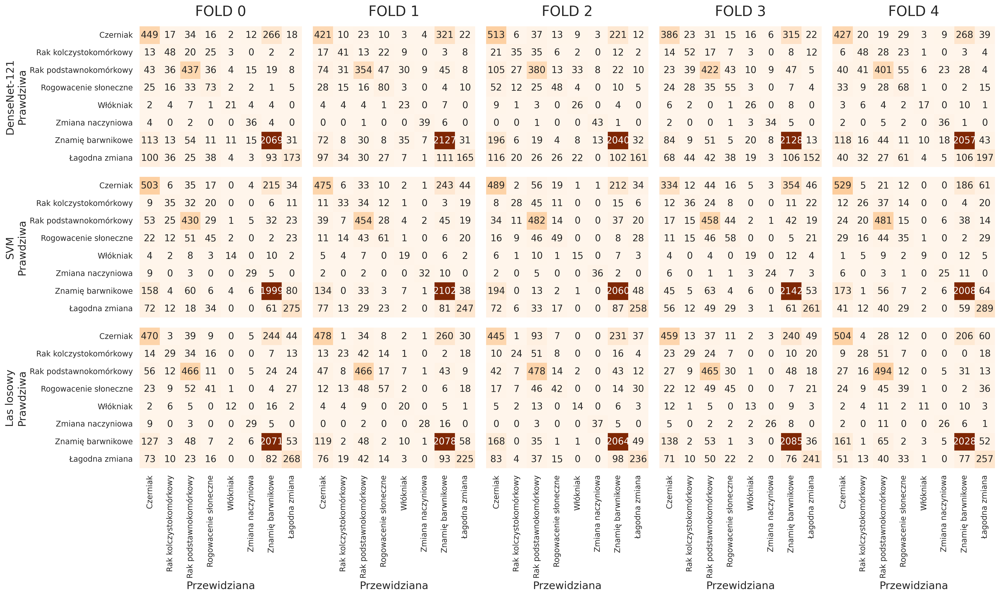

In [ ]:
plot_all_confusion_matrix(df_predictions, classes=class_names)

Sprawdźmy teraz kiedy modele się mylą w diagnozie, kiedy się zgadzają, a kiedy podejmują różne decyzje.

In [ ]:
# przygotowanie danych
# potrzebujemy wiedzieć dla każdego zdjęcia, czy dany model miał rację
df = df_predictions.copy()
df['Zgodność'] = df['y_true'] == df['y_pred']

# tabela przestawna: wiersz = próbka, Kolumna = model, Wartość = True/False (Czy poprawny?)
df['ID_próbki'] = df.groupby(['Model', 'Fold']).cumcount()
pivot_correct = df.pivot(index=['Fold', 'ID_próbki'], columns='Model', values='Zgodność').dropna()

models_list = pivot_correct.columns.tolist()
pairs = list(itertools.combinations(models_list, 2))

results = []

# obliczenia dla każdej pary
for m1, m2 in pairs:
    # wyciągamy wektory poprawności
    c1 = pivot_correct[m1]
    c2 = pivot_correct[m2]

    # zliczamy 4 stany
    both_correct = (c1 & c2).sum()
    both_wrong = (~c1 & ~c2).sum()
    m1_right_m2_wrong = (c1 & ~c2).sum()
    m2_right_m1_wrong = (~c1 & c2).sum()

    total = len(pivot_correct)

    results.append({
        'Para': f"{m1} vs {m2}",
        'Oba poprawne': both_correct / total * 100,
        'Oba błędne': both_wrong / total * 100,
        f'Tylko {m1}': m1_right_m2_wrong / total * 100,
        f'Tylko {m2}': m2_right_m1_wrong / total * 100
    })

df_res = pd.DataFrame(results)

# wyświetlamy tabelę liczbową
display(df_res.round(2))

# zapisujemy tabelę
df_res_save_path = os.path.join(RESULTS_DIR, "tabela_zgodnosci.csv")
df_res.to_csv(df_res_save_path, encoding='utf-8-sig')

,Para,Oba poprawne,Oba błędne,Tylko DenseNet-121,Tylko Las losowy,Tylko SVM
0,DenseNet-121 vs Las losowy,67.33,21.88,4.20,6.58,NaN
1,DenseNet-121 vs SVM,66.14,20.46,5.39,NaN,8.01
2,Las losowy vs SVM,69.13,21.07,NaN,4.79,5.02


## Porównanie statystyczne

### Test Shapiro-Wilka

In [ ]:
results = []

for metric in metric_cols:
    for model in models_unq:
        # pobieramy wyniki z foldów
        data = df_metrics[df_metrics['Model'] == model][metric].values

        # wykonujemy test Shapiro-Wilka
        stat, p_value = shapiro(data)

        # interpretacja
        is_normal = p_value > ALPHA

        results.append({
            'Metryka': metric,
            'Model': model,
            'Wartość p (p-value)': p_value,
            'Rozkład Normalny?': 'TAK' if is_normal else 'NIE'
        })

# tworzymy tabelę z wynikami
shapiro_df = pd.DataFrame(results)

# sortujemy dla czytelności (najpierw te, które NIE są normalne)
shapiro_df = shapiro_df.sort_values(by=['Metryka', 'Wartość p (p-value)'])

# wyświetlamy wyniki
shapiro_df

,Metryka,Model,Wartość p (p-value),Rozkład Normalny?
5,Czułość,Las losowy,0.189911,TAK
4,Czułość,SVM,0.567410,TAK
3,Czułość,DenseNet-121,0.970936,TAK
9,Dokładność,DenseNet-121,0.006798,NIE
10,Dokładność,SVM,0.077115,TAK
11,Dokładność,Las losowy,0.396935,TAK
1,MCC,SVM,0.034007,NIE
0,MCC,DenseNet-121,0.093139,TAK
2,MCC,Las losowy,0.977691,TAK
14,Precyzja,Las losowy,0.014909,NIE


Zapisujemy wyniki.

In [ ]:
csv_path = os.path.join(RESULTS_DIR, "test_normalnosci_shapiro.csv")
shapiro_df.round(5).to_csv(csv_path, encoding='utf-8-sig', index=False)

Narysujmy wykresy kwantyl-kwantyl.

In [ ]:
def visualize_qq_plots(df_metrics, metrics, save_dir=RESULTS_DIR, filename="wykresy_qq_metryki.pdf"):
    """
    Generuje macierz wykresów kwantylowych (Q-Q Plots) dla każdej pary model-metryka.

    Wizualizacja służy do weryfikacji założenia o normalności rozkładu wyników, co jest
    kluczowe przy wyborze testów statystycznych (parametryczne vs nieparametryczne).
    Punkty leżące wzdłuż czerwonej linii sugerują rozkład normalny. Wykres zawiera
    współczynnik determinacji R², określający jakość dopasowania do rozkładu teoretycznego.

    Układ siatki:
    - Wiersze: Poszczególne metryki.
    - Kolumny: Analizowane modele.

    Args:
        df_metrics (pd.DataFrame): Ramka danych z wynikami walidacji (musi zawierać kolumnę 'Model').
        metrics (list): Lista nazw kolumn (metryk) do wizualizacji.
        save_dir (str, optional): Ścieżka do katalogu zapisu.
        filename (str, optional): Nazwa pliku wyjściowego.
    """
    models_unq = df_metrics['Model'].unique()
    n_models = len(models_unq)
    n_metrics = len(metrics)

    # tworzymy siatkę wykresów
    fig, axes = plt.subplots(nrows=n_metrics, ncols=n_models,
                             figsize=(5 * n_models, 4 * n_metrics),
                             squeeze=False)

    for row_idx, metric in enumerate(metrics):
        for col_idx, model in enumerate(models_unq):
            ax = axes[row_idx, col_idx]

            # pobieramy dane
            subset = df_metrics[df_metrics['Model'] == model]
            if metric not in subset.columns:
                ax.text(0.5, 0.5, "Brak danych", ha='center', va='center')
                continue

            data = subset[metric].values

            # rysujemy wykres qq
            (osm, osr), (slope, intercept, r) = probplot(data, dist="norm", plot=ax)


            # tytuł tylko w pierwszym rzędzie (nazwa modelu)
            if row_idx == 0:
                ax.set_title(f"{model}", pad=15)
            else:
                ax.set_title("")

            # Ettykieta Y tylko w pierwszej kolumnie (nazwa metryki)
            if col_idx == 0:
                ax.set_ylabel(f"{metric}")
            else:
                ax.set_ylabel("")

            # etykieta X tylko w ostatnim rzędzie
            if row_idx == n_metrics - 1:
                ax.set_xlabel("Kwantyle teoretyczne")
            else:
                ax.set_xlabel("")

            # wyświetlenie R^2 wewnątrz wykresu (legenda)
            ax.text(0.05, 0.85, f"$R^2 = {r**2:.3f}$",
                    transform=ax.transAxes,
                    bbox=dict(boxstyle="round", fc="white", ec="gray", alpha=0.8))

            # styl linii i punktów
            ax.get_lines()[0].set_markerfacecolor('blue')
            ax.get_lines()[0].set_markersize(6.0)
            ax.get_lines()[1].set_color('red')
            ax.get_lines()[1].set_linewidth(1.5)
            ax.grid(True, linestyle='--', alpha=0.5)

    plt.suptitle("Analiza normalności rozkładu wyników", y=1.02)
    plt.tight_layout()

    # zapisujemy
    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path)

    plt.show()

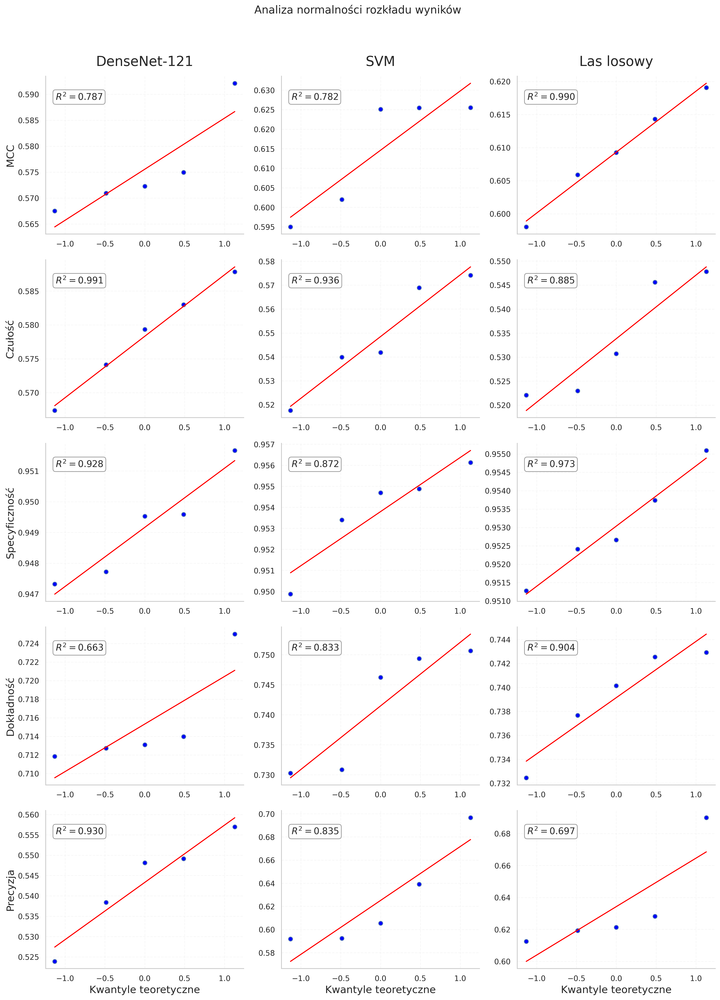

In [ ]:
visualize_qq_plots(df_metrics, metric_cols)

### Test Friedmana i test Nemenyi'ego

Przeprowadzamy test Friedmana.

In [ ]:
results = []

for metric in metric_cols:
    # tabela przestawna: wiersze=foldy, kolumny=modele
    df_pivot = df_metrics.pivot(index='Fold', columns='Model', values=metric)

    # test Friedmana
    stat, p_value = friedmanchisquare(*[df_pivot[col] for col in df_pivot.columns])

    results.append({
        'Metryka': metric,
        'Chi2 Stat': stat,
        'p-value': p_value,
        'Decyzja': 'ISTOTNA RÓŻNICA' if p_value < ALPHA else 'Brak różnic'
    })

# tworzymy tabelę z wynikami
df_friedman = pd.DataFrame(results)
df_friedman = df_friedman.sort_values('p-value')

# wyświetlamy wyniki
df_friedman

,Metryka,Chi2 Stat,p-value,Decyzja
1,Czułość,8.4,0.014996,ISTOTNA RÓŻNICA
0,MCC,7.6,0.022371,ISTOTNA RÓŻNICA
2,Specyficzność,7.6,0.022371,ISTOTNA RÓŻNICA
3,Dokładność,7.6,0.022371,ISTOTNA RÓŻNICA
4,Precyzja,7.6,0.022371,ISTOTNA RÓŻNICA


Zapisujemy wyniki.

In [ ]:
path = os.path.join(RESULTS_DIR, "friedman_wyniki.csv")
df_friedman.to_csv(path, index=False, encoding='utf-8-sig')

Przeprowadzamy test post-hoc test Nemenyi'ego.

In [ ]:
# filtrujemy metryki, które wymagają dalszej analizy (p < alpha)
significant_metrics = df_friedman[df_friedman['p-value'] < ALPHA]['Metryka'].tolist()

if not significant_metrics:
    print(f"Brak metryk spełniających warunek p < {ALPHA}. Koniec analizy.")
else:

    # pętla po istotnych metrykach
    for metric in significant_metrics:
        print(f"--- Test Nemenyi'ego dla {metric} ---")

        # przygotowanie danych
        df_pivot = df_metrics.pivot(index='Fold', columns='Model', values=metric)

        # przeprowadzenie testu Nemenyi'ego
        try:
            p_values_matrix = sp.posthoc_nemenyi_friedman(df_pivot)
        except Exception as e:
            print(f"Błąd przy obliczaniu Nemenyi dla {metric}: {e}")
            continue

        # wyświetlenie wyników
        print(f"Wyniki ({metric}):")
        display(p_values_matrix)

        # zapis wyników
        csv_filename = f"nemenyi_{metric}.csv"
        path = os.path.join(RESULTS_DIR, csv_filename)
        p_values_matrix.to_csv(path, encoding='utf-8-sig')

--- Test Nemenyi'ego dla Czułość ---
Wyniki (Czułość):


,DenseNet-121,Las losowy,SVM
DenseNet-121,1.000000,0.012310,0.139405
Las losowy,0.012310,1.000000,0.609411
SVM,0.139405,0.609411,1.000000


--- Test Nemenyi'ego dla MCC ---
Wyniki (MCC):


,DenseNet-121,Las losowy,SVM
DenseNet-121,1.000000,0.068887,0.030663
Las losowy,0.068887,1.000000,0.946370
SVM,0.030663,0.946370,1.000000


--- Test Nemenyi'ego dla Specyficzność ---
Wyniki (Specyficzność):


,DenseNet-121,Las losowy,SVM
DenseNet-121,1.000000,0.068887,0.030663
Las losowy,0.068887,1.000000,0.946370
SVM,0.030663,0.946370,1.000000


--- Test Nemenyi'ego dla Dokładność ---
Wyniki (Dokładność):


,DenseNet-121,Las losowy,SVM
DenseNet-121,1.000000,0.068887,0.030663
Las losowy,0.068887,1.000000,0.946370
SVM,0.030663,0.946370,1.000000


--- Test Nemenyi'ego dla Precyzja ---
Wyniki (Precyzja):


,DenseNet-121,Las losowy,SVM
DenseNet-121,1.000000,0.030663,0.068887
Las losowy,0.030663,1.000000,0.946370
SVM,0.068887,0.946370,1.000000


### Test Levene'a

In [ ]:
global_results = []

# pętla po metrykach
for metric in metric_cols:
    # tabela przestawna: wiersze=foldy, kolumny=modele
    df_pivot = df_metrics.pivot(index='Fold', columns='Model', values=metric)

    # pobieramy próbki dla każdego modelu
    samples = [df_pivot[col].values for col in df_pivot.columns]

    # wykonujemy test Levene'a
    stat, p_val = levene(*samples, center='median')

    global_results.append({
        'Metryka': metric,
        'Statystyka Levene': stat,
        'p-value': p_val,
        'Decyzja': 'ISTOTNA RÓŻNICA' if p_val < ALPHA else 'Brak różnic'
    })

# tworzymy tabelę
df_levene_global = pd.DataFrame(global_results)

# wyświetlamy wyniki
df_levene_global

,Metryka,Statystyka Levene,p-value,Decyzja
0,MCC,0.414238,0.669942,Brak różnic
1,Czułość,1.690635,0.225494,Brak różnic
2,Specyficzność,0.170245,0.845460,Brak różnic
3,Dokładność,1.311055,0.305511,Brak różnic
4,Precyzja,0.789937,0.476116,Brak różnic


Zapisujemy wyniki

In [ ]:
save_path = os.path.join(RESULTS_DIR, "levene_global_wyniki.csv")
df_levene_global.to_csv(save_path, index=False, encoding='utf-8-sig')

Przeprowadzamy porównanie parami.

In [ ]:
# pętla po każdej metryce
for metric in metric_cols:
    print(f"--- Test Levene'a parami dla metryki: {metric} ---")

    # przygotowanie danych
    df_pivot = df_metrics.pivot(index='Fold', columns='Model', values=metric)
    models_levene = df_pivot.columns.tolist()

    # generujemy pary
    pairs = list(itertools.combinations(models_levene, 2))
    n_comparisons = len(pairs)

    if n_comparisons == 0:
        print("Za mało modeli do porównań parowych.")
        continue

    # obliczamy poprawkę Bonferroniego
    alpha_bonf = ALPHA / n_comparisons
    print(f"Liczba par: {n_comparisons} | Alpha skorygowane: {alpha_bonf:.5f}")

    pair_results = []

    for m1, m2 in pairs:
        # pobieramy wyniki foldów dla pary
        sample1 = df_pivot[m1].values
        sample2 = df_pivot[m2].values

        # test Levene'a
        stat, p = levene(sample1, sample2, center='median')

        # sprawdzamy kto jest stabilniejszy (mniejsze odchylenie standardowe = lepiej)
        std1 = np.std(sample1)
        std2 = np.std(sample2)

        is_significant = p < alpha_bonf

        # wybór stabilniejszego modelu
        if is_significant:
            if std1 < std2:
                better = f"{m1} (std={std1:.3f})"
            else:
                better = f"{m2} (std={std2:.3f})"
        else:
            better = "-" # Brak istotnej różnicy

        pair_results.append({
            'Para modeli': f"{m1} vs {m2}",
            'p-value': p,
            'Istotna różnica?': 'TAK' if is_significant else 'NIE',
            'Stabilniejszy model': better,
            'Odchylenie standardowe M1': std1,
            'Odchylenie standardowe M2': std2
        })

    # tworzymy tabelę dla danej metryki
    df_pairs = pd.DataFrame(pair_results)

    # wyświetlamy wyniki
    display(df_pairs)

    # zapisujemy wyniki
    filename = f"levene_pary_{metric}.csv"
    save_path = os.path.join(RESULTS_DIR, filename)
    df_pairs.to_csv(save_path, index=False, encoding='utf-8-sig')

--- Test Levene'a parami dla metryki: MCC ---
Liczba par: 3 | Alpha skorygowane: 0.01667


,Para modeli,p-value,Istotna różnica?,Stabilniejszy model,Odchylenie standardowe M1,Odchylenie standardowe M2
0,DenseNet-121 vs Las losowy,0.967736,NIE,-,0.008627,0.007209
1,DenseNet-121 vs SVM,0.516176,NIE,-,0.008627,0.013350
2,Las losowy vs SVM,0.495098,NIE,-,0.007209,0.013350


--- Test Levene'a parami dla metryki: Czułość ---
Liczba par: 3 | Alpha skorygowane: 0.01667


,Para modeli,p-value,Istotna różnica?,Stabilniejszy model,Odchylenie standardowe M1,Odchylenie standardowe M2
0,DenseNet-121 vs Las losowy,0.326778,NIE,-,0.007080,0.010945
1,DenseNet-121 vs SVM,0.147181,NIE,-,0.007080,0.020760
2,Las losowy vs SVM,0.339633,NIE,-,0.010945,0.020760


--- Test Levene'a parami dla metryki: Specyficzność ---
Liczba par: 3 | Alpha skorygowane: 0.01667


,Para modeli,p-value,Istotna różnica?,Stabilniejszy model,Odchylenie standardowe M1,Odchylenie standardowe M2
0,DenseNet-121 vs Las losowy,0.755014,NIE,-,0.001553,0.001292
1,DenseNet-121 vs SVM,0.769459,NIE,-,0.001553,0.002144
2,Las losowy vs SVM,0.608329,NIE,-,0.001292,0.002144


--- Test Levene'a parami dla metryki: Dokładność ---
Liczba par: 3 | Alpha skorygowane: 0.01667


,Para modeli,p-value,Istotna różnica?,Stabilniejszy model,Odchylenie standardowe M1,Odchylenie standardowe M2
0,DenseNet-121 vs Las losowy,0.943856,NIE,-,0.004885,0.003841
1,DenseNet-121 vs SVM,0.256185,NIE,-,0.004885,0.009023
2,Las losowy vs SVM,0.219149,NIE,-,0.003841,0.009023


--- Test Levene'a parami dla metryki: Precyzja ---
Liczba par: 3 | Alpha skorygowane: 0.01667


,Para modeli,p-value,Istotna różnica?,Stabilniejszy model,Odchylenie standardowe M1,Odchylenie standardowe M2
0,DenseNet-121 vs Las losowy,0.550293,NIE,-,0.011352,0.028263
1,DenseNet-121 vs SVM,0.233592,NIE,-,0.011352,0.039649
2,Las losowy vs SVM,0.546483,NIE,-,0.028263,0.039649


## Wyniki na zbiorze testowym

### Zebranie wyników i predykcji

In [ ]:
class ISICDataset(Dataset):
    """
    Niestandardowy Dataset PyTorch do wczytywania obrazów dermatologicznych ISIC.

    Klasa wczytuje obrazy na podstawie ścieżek z DataFrame, konwertuje je do RGB
    i zwraca w formie gotowej do przetworzenia przez model.
    """

    def __init__(self, dataframe, root_dir, transform=None):
        """
        Inicjalizuje dataset.

        Args:
            dataframe (pd.DataFrame): Ramka danych zawierająca co najmniej kolumny:
                                      - 'nazwa_pliku': nazwa pliku z rozszerzeniem (np. 'IMG_1.jpg')
                                      - 'target': numeryczna etykieta klasy (int).
            root_dir (str): Ścieżka do katalogu głównego, w którym znajdują się obrazy.
            transform (callable, optional): Opcjonalne transformacje (np. augmentacja, normalizacja)
                                            aplikowane na obrazie. Domyślnie None.
        """
        self.df = dataframe
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        """Zwraca całkowitą liczbę próbek w zbiorze."""
        return len(self.df)

    def __getitem__(self, idx):
        """
        Pobiera pojedynczą próbkę danych o podanym indeksie.

        Args:
            idx (int/tensor): Indeks próbki do pobrania.

        Returns:
            tuple: Krotka (image, label), gdzie:
                   - image (PIL.Image lub Tensor): Obraz po transformacjach.
                   - label (int): Numeryczna etykieta klasy.
        """
        if torch.is_tensor(idx):
            idx = idx.tolist()

        # pobranie nazwy pliku
        img_name = self.df.iloc[idx]['nazwa_pliku']
        img_path = os.path.join(self.root_dir, img_name)

        # wczytanie obrazu i konwersja na RGB (dla bezpieczeństwa)
        image = Image.open(img_path).convert('RGB')

        # pobranie etykiety numerycznej (target)
        label = self.df.iloc[idx]['target']

        if self.transform:
            image = self.transform(image)

        return image, label

In [ ]:
working_size = int(IMG_SIZE * 1.25)

val_transforms = transforms.Compose([
    # zmiana wymiarów
    transforms.Resize(working_size),
    # wycinamy środek obrazu w docelowych wymiarach
    transforms.CenterCrop(IMG_SIZE),
    transforms.ToTensor(),
    transforms.Normalize(NORM_MEAN, NORM_STD)
])

In [ ]:
def get_model(device=DEVICE):
    """
    Inicjalizuje model DenseNet-121 i dostosowuje go do klasyfikacji zmian skórnych.

    Funkcja przygotowuje architekturę poprzez:
    1. Załadowanie szkieletu sieci DenseNet-121 (z losową inicjalizacją wag - trening od zera).
    2. Pobranie liczby cech wejściowych ostatniej warstwy.
    3. Zastąpienie oryginalnego klasyfikatora nową sekwencją (Dropout + Linear),
       dostosowaną do specyficznej liczby klas w zbiorze ISIC.
    4. Przeniesienie modelu na wskazane urządzenie obliczeniowe.

    Args:
        device (torch.device): Urządzenie (CPU lub CUDA), na którym ma działać model.

    Returns:
        torch.nn.Module: Skompilowany model PyTorch z nową głowicą (head), gotowy do treningu.
    """
    # pobieramy model
    model = models.densenet121(weights=None, drop_rate=0.15)

    # pobieramy liczbę cech wchodzących do ostatniej warstwy (dla DenseNet121 to 1024)
    in_features = model.classifier.in_features

    # odmieniamy warstwę klasyfikacyjną (dodajemy Dropout)
    model.classifier = nn.Sequential(
        nn.Dropout(0.5),
        nn.Linear(in_features, NUM_CLASSES)
    )

    # przenosimy model na GPU (jeśli dostępne)
    model = model.to(device)

    return model

In [ ]:
def calculate_specificity(y_true, y_pred, num_classes):
    """
    Oblicza średnią specyficzność dla klasyfikacji wieloklasowej.

    Funkcja wykorzystuje strategię One-vs-Rest, obliczając specyficzność niezależnie
    dla każdej klasy (binarna klasyfikacja: dana klasa vs reszta), a następnie zwraca
    ich średnią arytmetyczną. Jest to kluczowa metryka w diagnostyce,
    określająca zdolność modelu do poprawnego wykluczania danej choroby.

    Args:
        y_true (array-like): Wektor rzeczywistych etykiet.
        y_pred (array-like): Wektor przewidzianych etykiet.
        num_classes (int): Całkowita liczba klas w modelu.

    Returns:
        float: Uśredniona wartość specyficzności (zakres 0.0 - 1.0).
    """
    cm = confusion_matrix(y_true, y_pred, labels=range(num_classes))
    specificity_per_class = []

    for i in range(num_classes):
        # dla klasy 'i':
        # TN = suma wszystkich próbek, które nie są 'i' i nie zostały przewidziane jako 'i'
        # FP = próbki, które nie są 'i', ale zostały przewidziane jako 'i'

        # wartości w macierzt pomyłek:
        # cm[i, i] to TP
        # cm[:, i] to kolumna predykcji (suma to TP + FP) -> FP = suma_kol - TP
        # cm[i, :] to wiersz prawdy (suma to TP + FN)
        # suma całkowita to total

        tp = cm[i, i]
        fp = cm[:, i].sum() - tp
        fn = cm[i, :].sum() - tp
        tn = cm.sum() - (tp + fp + fn)

        # Specyficzność = TN / (TN + FP) z mechanizm uniknięcia dzielenia przez 0
        if (tn + fp) > 0:
            spec = tn / (tn + fp)
        else:
            spec = 0.0
        specificity_per_class.append(spec)

    return np.mean(specificity_per_class)

In [ ]:
def get_densenet_extractor(weights_path, device):
    """
    Wczytuje wytrenowany model DenseNet-121 i konwertuje go na ekstraktor cech.

    Funkcja najpierw odtwarza architekturę użytą podczas treningu (aby poprawnie
    wczytać wagi), a następnie zamienia warstwę klasyfikacyjną na funkcję tożsamościową,
    dzięki czemu model zwraca wektory cech zamiast predykcji klas.

    Args:
        weights_path (str): Ścieżka do pliku .pth z zapisanymi wagami modelu.
        device (torch.device): Urządzenie (CPU/GPU), na które ma trafić model.

    Returns:
        torch.nn.Module: Model w trybie ewaluacji, zwracający cechy (embeddings).
                         Zwraca None, jeśli wczytanie wag się nie powiedzie.
    """
    # inicjalizujemy pusty model
    model = models.densenet121(weights=None)
    in_features = model.classifier.in_features

    # odtwarzamy warstwę klasyfikacyjną z notatnika z treningu
    model.classifier = nn.Sequential(
        nn.Dropout(0.5),
        nn.Linear(in_features, NUM_CLASSES)
    )

    # wczytujemy wagi
    try:
        state_dict = torch.load(weights_path, map_location=device)
        model.load_state_dict(state_dict)
        print(f"  -> Wczytano wagi modelu: {os.path.basename(weights_path)}")
    except FileNotFoundError:
        print(f"  [BŁĄD] Nie znaleziono pliku wag: {weights_path}")
        return None
    except Exception as e:
        print(f"  [BŁĄD] Problem z wczytaniem wag: {e}")
        return None

    # modyfikujemy warstwę klasyfikacyjną, aby zwracała ostatni wynik warstw splotowych
    model.classifier = nn.Identity()

    # przenosimy na GPU (jeśli dostępne)
    model.to(device)
    # włączamy tryb ewaluacji
    model.eval()
    return model

In [ ]:
def load_feature_extractor(fold_idx):
    """
    Wczytuje model DenseNet (jako ekstraktor cech) dla wskazanego foldu walidacji krzyżowej.

    Funkcja konstruuje ścieżkę do pliku z wagami na podstawie indeksu foldu
    (np. 'densenet121_fold_0.pth'), a następnie inicjalizuje model w trybie ewaluacji.

    Args:
        fold_idx (int): Numer foldu (np. 0, 1, 2...), dla którego ma zostać wczytany model.

    Returns:
        torch.nn.Module: Model gotowy do ekstrakcji cech.
                         Zwraca None, jeśli plik z wagami nie istnieje (z wypisaniem ostrzeżenia).
    """
    # tworzymy ścieżkę pliku
    weights_filename = f'{MODEL_NAME}_fold{fold_idx}.pth'
    model_path = os.path.join(MODELS_DIR, weights_filename)

    # przygotowujemy model
    model = get_densenet_extractor(model_path, DEVICE)

    if model is None:
        print(f"[WARNING] Pominięto fold {fold_idx} z powodu braku pliku wag.")
        return None

    return model

In [ ]:
def extract_features(model, loader, device):
    """
    Generuje wektory cech dla całego zbioru danych przy użyciu modelu.

    Funkcja iteruje przez DataLoader, przetwarza obrazy w trybie ewaluacji (bez liczenia gradientów)
    i zwraca wynikowe cechy w formacie NumPy, gotowym dla klasycznych modeli ML.

    Args:
        model (torch.nn.Module): Model sieci neuronowej pełniący rolę ekstraktora cech.
        loader (DataLoader): DataLoader dostarczający dane (zalecane shuffle=False).
        device (torch.device): Urządzenie obliczeniowe (CPU lub CUDA).

    Returns:
        tuple: Krotka (X, y), gdzie:
               - X (np.ndarray): Macierz cech o wymiarach [liczba_próbek, liczba_cech].
               - y (np.ndarray): Wektor etykiet o wymiarach [liczba_próbek].
    """
    model.eval()  # włączamy tryb ewaluacji

    all_features = []
    all_labels = []

    # wyłączamy obliczanie gradientów dla oszczędności pamięci i przyspieszenia
    with torch.no_grad():
        for inputs, labels in tqdm(loader, desc="Ekstrakcja cech", leave=False):
            inputs = inputs.to(device)

            # Przepuszczamy obraz przez sieć
            features = model(inputs)

            # przenosimy wyniki z GPU na CPU i zamieniamy na numpy array
            all_features.append(features.cpu().numpy())
            all_labels.append(labels.numpy())

    # łączymy wyniki ze wszystkich batchy w jedną dużą tablicę
    # X będzie miało wymiar [liczba_zdjęć, liczba_cech]
    X = np.concatenate(all_features, axis=0)
    y = np.concatenate(all_labels, axis=0)

    return X, y

In [ ]:
def process_test_features(model, test_loader, fold_idx, device):
    """
    Ekstrahuje cechy ze zbioru testowego i standaryzuje je przy użyciu zapisanego skalera.

    Funkcja zapewnia spójność przetwarzania danych poprzez wczytanie obiektu StandardScaler
    dopasowanego wcześniej do danych treningowych konkretnego foldu. Dzięki temu dane testowe
    są transformowane według tych samych statystyk (średnia, odchylenie), co zapobiega
    błędom metodologicznym (train-test mismatch).

    Args:
        model (torch.nn.Module): Model ekstraktora cech (w trybie eval).
        test_loader (DataLoader): Loader z danymi testowymi.
        fold_idx (int): Indeks foldu, używany do wczytania odpowiedniego pliku .joblib ze skalerem.
        device (torch.device): Urządzenie obliczeniowe.

    Returns:
        np.ndarray: Macierz cech po ekstrakcji i standaryzacji (lub surowa, jeśli brak skalera).
    """
    # ekstrakcja cech
    X_test_raw, _ = extract_features(model, test_loader, device)

    # wczytujemy scaler dla tego konkretnego foldu
    scaler_path = os.path.join(MODELS_DIR, f'scaler_fold_{fold_idx}.joblib')

    if not os.path.exists(scaler_path):
        print(f"[OSTRZEŻENIE] Brak scalera dla foldu {fold_idx}! Dane nie zostaną przeskalowane.")
        return X_test_raw

    scaler = joblib.load(scaler_path)

    # transformacja danych
    X_test_scaled = scaler.transform(X_test_raw)

    return X_test_scaled

In [ ]:
df

,Model,Fold,y_true,y_pred,Zgodność,ID_próbki
0,DenseNet-121,0,6,6,True,0
1,DenseNet-121,0,6,6,True,1
2,DenseNet-121,0,6,6,True,2
3,DenseNet-121,0,0,6,False,3
4,DenseNet-121,0,6,6,True,4
...,...,...,...,...,...,...
68389,Las losowy,4,6,0,False,4554
68390,Las losowy,4,1,1,True,4555
68391,Las losowy,4,0,0,True,4556
68392,Las losowy,4,6,6,True,4557


Przygotujemy zbiór testowy oraz potrzebne klasy.

In [ ]:
test_df = df_metadata[df_metadata['typ_puli'] == 'test'].reset_index(drop=True)
print(f"Liczba próbek testowych: {len(test_df)}")

# instancje klas
test_dataset = ISICDataset(test_df, root_dir=IMG_DIR, transform=val_transforms)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=NUM_WORKERS)

# wartości etykiet rzeczywistych
y_test_true = test_df['target'].values

Liczba próbek testowych: 2533


Zbieramy predykcje i wyniki testowe dla modelu DenseNet.

In [ ]:
all_folds_probs_list = []
successful_models = 0

# pętla po modelach
for fold_idx in range(CV_FOLDS):
    weight_path = os.path.join(MODELS_DIR, f'{MODEL_NAME}_fold{fold_idx}.pth')

    if not os.path.exists(weight_path):
        print(f"[SKIP] Brak wag dla foldu {fold_idx}")
        continue

    print(f" -> Przetwarzanie modelu: Fold {fold_idx}.")

    # wczytujemy model wraz z wytrenowanymi wagami
    model = get_model(DEVICE)
    model.load_state_dict(torch.load(weight_path, map_location=DEVICE))
    model.eval()

    fold_probs = []

    # zbieramy wyniki
    with torch.no_grad():
        for images, _ in tqdm(test_loader, leave=False, desc=f"Fold {fold_idx}"):
            images = images.to(DEVICE)
            outputs = model(images)
            probs = F.softmax(outputs, dim=1) # zamiana na prawdopodobieństwa (0-1)
            fold_probs.append(probs.cpu().numpy())

    # łączymy partie dla tego jednego modelu
    full_fold_probs = np.concatenate(fold_probs, axis=0)

    # dodajemy do listy zbiorczej
    all_folds_probs_list.append(full_fold_probs)
    successful_models += 1

    # czyścimy pamięć
    del model
    torch.cuda.empty_cache()

if successful_models == 0:
    print("Błąd: Nie znaleziono żadnego modelu!")
else:
    # tworzymy macierz
    ensemble_stack = np.stack(all_folds_probs_list, axis=0)

    # średni wynik
    avg_probs = np.mean(ensemble_stack, axis=0)

    # odchulenie standardowe
    std_probs = np.std(ensemble_stack, axis=0)

    # ostateczna predykcja
    y_test_pred = np.argmax(avg_probs, axis=1)

    # obliczamy metryki
    acc = accuracy_score(y_test_true, y_test_pred)
    mcc = matthews_corrcoef(y_test_true, y_test_pred)
    sens = recall_score(y_test_true, y_test_pred, average='macro', zero_division=0)
    prec = precision_score(y_test_true, y_test_pred, average='macro', zero_division=0)
    spec = calculate_specificity(y_test_true, y_test_pred, NUM_CLASSES)

    # średnia niepewność modelu (średnie odchylenie standardowe dla wybranej klasy)
    chosen_class_std = std_probs[np.arange(len(y_test_pred)), y_test_pred]
    mean_uncertainty = np.mean(chosen_class_std)

    # zapisujemy metryki
    metrics = {
        'model': MODEL_NAME,
        'dokladnosc': float(acc),
        'mcc': float(mcc),
        'czulosc': float(sens),
        'precyzja': float(prec),
        'specyficznosc': float(spec),
        'srednia_niepewnosc_modelu': float(mean_uncertainty), # To był główny problem
        'liczba_modeli': int(successful_models)
    }

    # zapisujemy do JSON
    with open(os.path.join(RESULTS_DIR, f'{MODEL_NAME}_metryki_testowe.json'), 'w') as f:
        json.dump(metrics, f, indent=4)

    # zapisujemy predykcja
    preds_df = pd.DataFrame({
        'id_zdjecia': test_df['id_zdjecia'], # lub 'id_zdjecia' zależy jak masz w DF
        'y_true': y_test_true,
        'y_pred': y_test_pred,
        'niepewnosc': chosen_class_std
    })

    # zapisujemy prawdopodobieństwa
    for i in range(NUM_CLASSES):
        preds_df[f'prob_class_{i}'] = avg_probs[:, i]

    preds_df.to_csv(os.path.join(RESULTS_DIR, f'{MODEL_NAME}_predykcje_testowe.csv'), index=False)

 -> Przetwarzanie modelu: Fold 0.


 -> Przetwarzanie modelu: Fold 1.


 -> Przetwarzanie modelu: Fold 2.


 -> Przetwarzanie modelu: Fold 3.


 -> Przetwarzanie modelu: Fold 4.


Zbieramy predykcje i wyniki testowe dla modeli hybrydowych.

In [ ]:
hybrid_preds_accumulated = {
    'SVM': [],
    'Las losowy': []
}
successful_folds = 0

for fold_idx in range(CV_FOLDS):
    # ścieżki
    densenet_path = os.path.join(MODELS_DIR, f'{MODEL_NAME}_fold{fold_idx}.pth')
    svm_path = os.path.join(MODELS_DIR, f'svm_fold_{fold_idx}.pkl')
    rf_path = os.path.join(MODELS_DIR, f'rf_fold_{fold_idx}.pkl')

    if not (os.path.exists(densenet_path) and os.path.exists(svm_path)):
        print(f"[SKIP] Brak modeli dla foldu {fold_idx}")
        continue

    print(f"\n-> Fold {fold_idx}: Przetwarzanie...")

    # wczytujemy ekstraktor
    feature_extractor = get_densenet_extractor(densenet_path, DEVICE)
    if feature_extractor is None: continue

    # wyciągamy cechy i skalujemy
    X_test_scaled = process_test_features(feature_extractor, test_loader, fold_idx, DEVICE)

    # czyścimy pamięć
    del feature_extractor
    torch.cuda.empty_cache()

    # wyznaczamy predykcje dla SVM
    svm_model = joblib.load(svm_path)
    svm_probs = svm_model.predict_proba(X_test_scaled)
    hybrid_preds_accumulated['SVM'].append(svm_probs)

    # wyznaczamy predykcje dla lasu losowego
    rf_model = joblib.load(rf_path)
    rf_probs = rf_model.predict_proba(X_test_scaled)
    hybrid_preds_accumulated['Las losowy'].append(rf_probs)

    successful_folds += 1

# podsumowanie i zapis wyników
if successful_folds > 0:
    for model_name, probs_list in hybrid_preds_accumulated.items():
        print(f"\nGenerowanie wyników dla: {model_name}")

        # średnia i odchylenie
        ensemble_stack = np.stack(probs_list, axis=0)
        avg_probs = np.mean(ensemble_stack, axis=0)
        std_probs = np.std(ensemble_stack, axis=0)
        # decyzja końcowa
        y_pred = np.argmax(avg_probs, axis=1)

        # obliczanie metryk
        acc = accuracy_score(y_test_true, y_pred)
        mcc = matthews_corrcoef(y_test_true, y_pred)
        sens = recall_score(y_test_true, y_pred, average='macro', zero_division=0)
        prec = precision_score(y_test_true, y_pred, average='macro', zero_division=0)
        spec = calculate_specificity(y_test_true, y_pred, NUM_CLASSES)

        # średnia niepewność modelu (średnie odchylenie standardowe dla wybranej klasy)
        chosen_class_std = std_probs[np.arange(len(y_pred)), y_pred]
        mean_uncertainty = np.mean(chosen_class_std)

        # zapis metryk do JSON
        metrics = {
            'model': model_name,
            'dokladnosc': float(acc),
            'mcc': float(mcc),
            'czulosc': float(sens),
            'precyzja': float(prec),
            'specyficznosc': float(spec),
            'srednia_niepewnosc_modelu': float(mean_uncertainty), # To jest najważniejsze
            'liczba_modeli': int(successful_folds)
        }

        # bezpieczna nazwa pliku (np. "Las losowy" -> "Las_losowy")
        safe_filename = model_name.replace(" ", "_")

        json_path = os.path.join(RESULTS_DIR, f'{safe_filename}_metryki_testowe.json')
        with open(json_path, 'w') as f:
            json.dump(metrics, f, indent=4)

        # zapis predykcji do CSV
        preds_df = pd.DataFrame({
            'id_zdjecia': test_df['id_zdjecia'],
            'y_true': y_test_true,
            'y_pred': y_pred,
            'niepewnosc': chosen_class_std
        })

        # dodajemy kolumny z prawdopodobieństwem dla każdej klasy
        for i in range(NUM_CLASSES):
            preds_df[f'prob_class_{i}'] = avg_probs[:, i]

        csv_path = os.path.join(RESULTS_DIR, f'{safe_filename}_predykcje_testowe.csv')
        preds_df.to_csv(csv_path, index=False)

        print(f" -> Zapisano komplet wyników: {safe_filename}")

else:
    print("Błąd: Nie udało się przetworzyć żadnego foldu.")


-> Fold 0: Przetwarzanie...
  -> Wczytano wagi modelu: DenseNet-121_fold0.pth



-> Fold 1: Przetwarzanie...
  -> Wczytano wagi modelu: DenseNet-121_fold1.pth



-> Fold 2: Przetwarzanie...
  -> Wczytano wagi modelu: DenseNet-121_fold2.pth



-> Fold 3: Przetwarzanie...
  -> Wczytano wagi modelu: DenseNet-121_fold3.pth



-> Fold 4: Przetwarzanie...
  -> Wczytano wagi modelu: DenseNet-121_fold4.pth



Generowanie wyników dla: SVM
 -> Zapisano komplet wyników: SVM

Generowanie wyników dla: Las losowy
 -> Zapisano komplet wyników: Las_losowy


### Porównanie metryk i predykcji

Przeanalizujemy wybrane wyniki.

In [ ]:
# szukamy plików
pattern = os.path.join(RESULTS_DIR, "*_metryki_testowe.json")
files = glob.glob(pattern)

data = []

for file_path in files:
    with open(file_path, 'r') as f:
        metrics = json.load(f)

        # dodajemy wiersz do tabeli
        data.append({
            'Model': metrics['model'],
            'MCC': metrics['mcc'],
            'Dokładność': metrics['dokladnosc'],
            'Czułość': metrics['czulosc'],
            'Specyficzność': metrics['specyficznosc'],
            'Precyzja': metrics['precyzja'],
            'Niepewność': metrics.get('srednia_niepewnosc_modelu', 0.0)
        })

if not data:
    print("Nie znaleziono żadnych plików z wynikami!")
else:
    # tworzymy DataFrame
    df_test = pd.DataFrame(data)

    # sortujemy malejąco po MCC
    df_test = df_test.sort_values(by='MCC', ascending=False).reset_index(drop=True)

    # zapisujemy tabelę
    csv_filename = 'ranking_modeli_test.csv'
    save_path = os.path.join(RESULTS_DIR, csv_filename)
    df_test.to_csv(save_path, index=False)

df_test

,Model,MCC,Dokładność,Czułość,Specyficzność,Precyzja,Niepewność
0,SVM,0.666822,0.779313,0.568270,0.957536,0.705450,0.119821
1,Las losowy,0.639190,0.760758,0.540859,0.955302,0.717987,0.064647
2,DenseNet-121,0.586078,0.727596,0.548232,0.947024,0.563305,0.090888


In [ ]:
def plot_metrics_comparison(df, metrics, save_dir=RESULTS_DIR, filename="skutecznosc_modeli_test.pdf"):
    """
    Generuje zgrupowany wykres słupkowy porównujący wyniki modeli dla wybranych metryk.

    Wizualizacja przedstawia modele obok siebie dla każdej z metryk (np. Accuracy, F1),
    co ułatwia bezpośrednie porównanie ich skuteczności na zbiorze testowym.
    Wykres zawiera również etykiety z dokładnymi wartościami liczbowymi nad każdym słupkiem.

    Args:
        df (pd.DataFrame): Ramka danych z wynikami (musi zawierać kolumnę 'Model' i kolumny metryk).
        metrics (list): Lista nazw kolumn (metryk) do uwzględnienia na wykresie.
        save_dir (str, optional): Ścieżka do katalogu zapisu (domyślnie RESULTS_DIR).
        filename (str, optional): Nazwa pliku wyjściowego (domyślnie "skutecznosc_modeli_test.png").
    """
    if df is None: return

    # przekształcamy dane z formatu szerokiego na długi
    df_melted = df.melt(id_vars=['Model'],
                        value_vars=metrics,
                        var_name='Metryka',
                        value_name='Wartość')

    # rysujemy wykres słupkowy
    chart = sns.barplot(data=df_melted, x='Metryka', y='Wartość', hue='Model', palette='viridis')

    # kosmetyka
    plt.title("Porównanie skuteczności modeli na zbiorze testowym")
    plt.ylim(0, 1.05)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Model')

    # dodajemy wartości liczbowe nad słupkami
    for container in chart.containers:
        chart.bar_label(container, fmt='%.2f', padding=3, fontsize=10)

    plt.tight_layout()
    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path)

    plt.show()

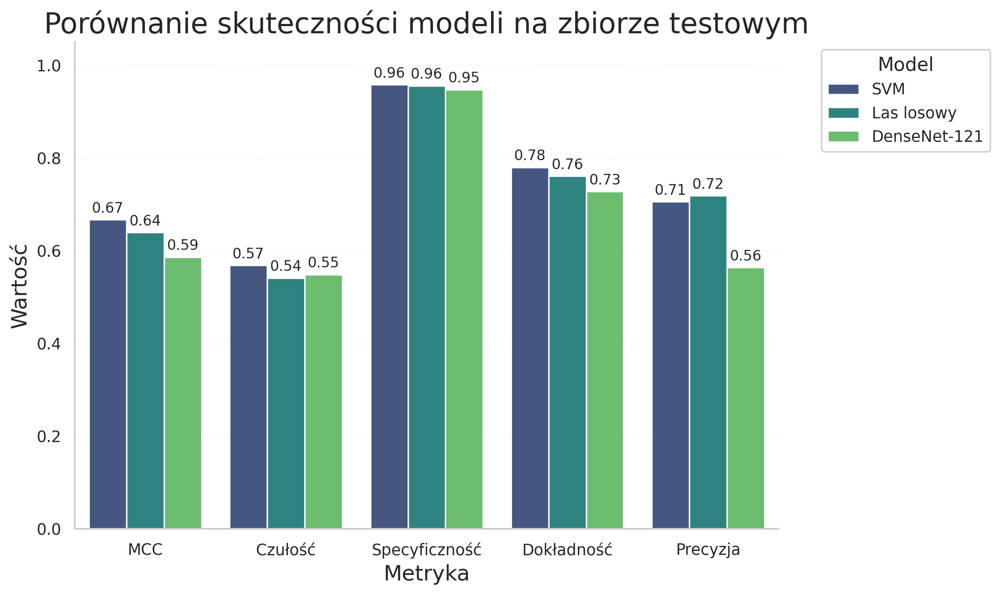

In [ ]:
plot_metrics_comparison(df_test, metric_cols)

In [ ]:
def plot_test_confusion_matrices(results_dir, models_list, class_labels, save_dir=RESULTS_DIR):

    for model_name in models_list:
        # tworzymy osobną figurę dla każdego modelu
        fig, ax = plt.subplots(figsize=(12, 10))

        # bezpieczna nazwa pliku (do wczytania CSV)
        safe_name_csv = model_name.replace(" ", "_")
        csv_path = os.path.join(results_dir, f"{safe_name_csv}_predykcje_testowe.csv")

        if not os.path.exists(csv_path):
            print(f"[WARNING] Brak pliku: {csv_path}")
            # jeśli brak pliku, zamykamy figurę i idziemy dalej
            plt.close(fig)
            continue

        # wczytujemy predykcje
        preds_df = pd.read_csv(csv_path)
        y_true = preds_df['y_true']
        y_pred = preds_df['y_pred']

        # liczymy macierz surową
        cm = confusion_matrix(y_true, y_pred)

        # liczymy macierz znormalizowaną
        with np.errstate(divide='ignore', invalid='ignore'):
            cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            cm_norm = np.nan_to_num(cm_norm)

        # tworzymy hybrydowe etykiety: "Liczba\n(Procent%)"
        labels = [f"{val}\n({norm:.1%})" for val, norm in zip(cm.flatten(), cm_norm.flatten())]
        labels = np.asarray(labels).reshape(cm.shape)

        # rysujemy
        sns.heatmap(
            cm_norm,
            annot=labels,
            fmt='',
            cmap='Blues',
            cbar=False,
            xticklabels=class_labels,
            yticklabels=class_labels,
            ax=ax,
            vmin=0, vmax=1,
            annot_kws={"size": 14}
        )

        # kosmetyka
        ax.set_title(f"{model_name}", pad=20)
        ax.set_xlabel("Przewidziana klasa")
        ax.set_ylabel("Prawdziwa klasa")

        # obracamy etykiety osi
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', rotation=0)
        ax.set_xticklabels(ax.get_xticklabels(), ha='right', rotation_mode='anchor')

        plt.tight_layout()

        # zapisujemy
        safe_model_name_out = str(model_name).replace(" ", "_")
        current_filename = f"macierz_pomylek_{safe_model_name_out}_test.pdf"

        save_path = os.path.join(save_dir, current_filename)
        plt.savefig(save_path)

        plt.show()

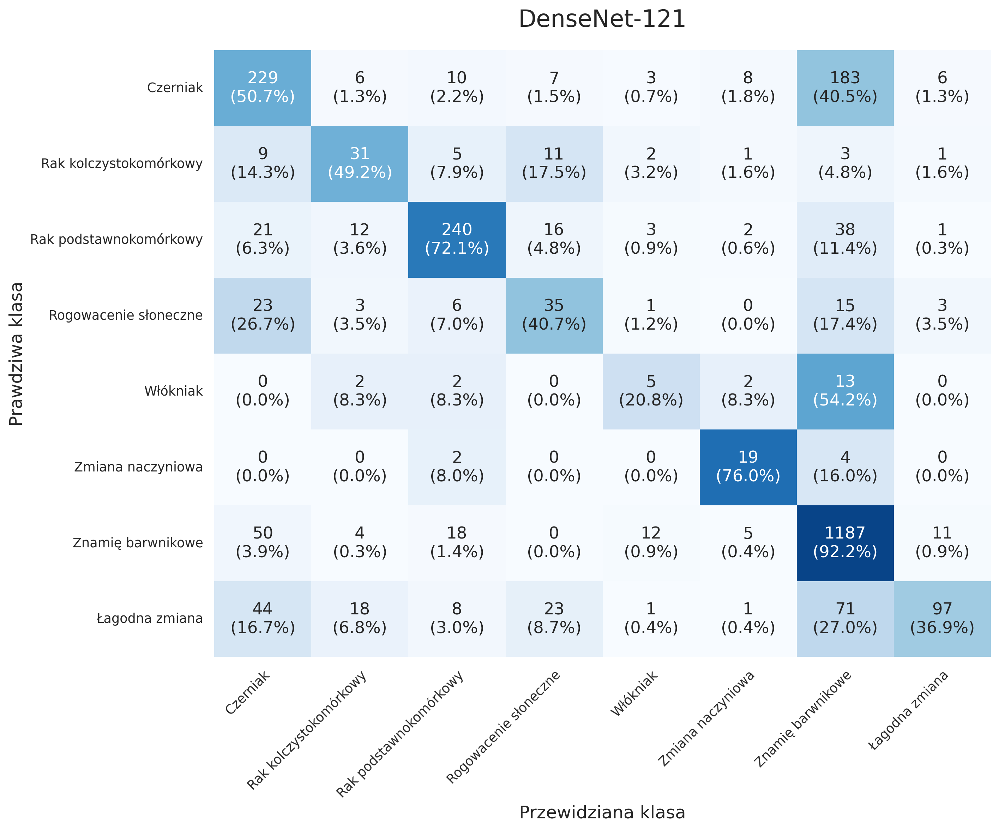

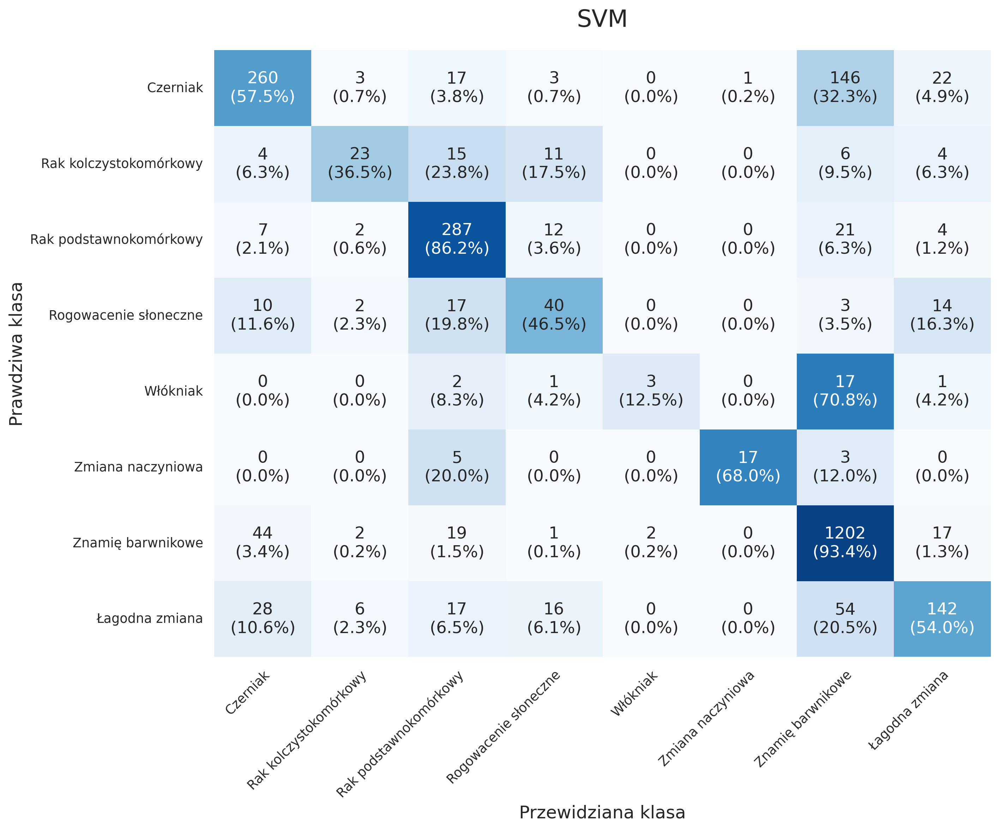

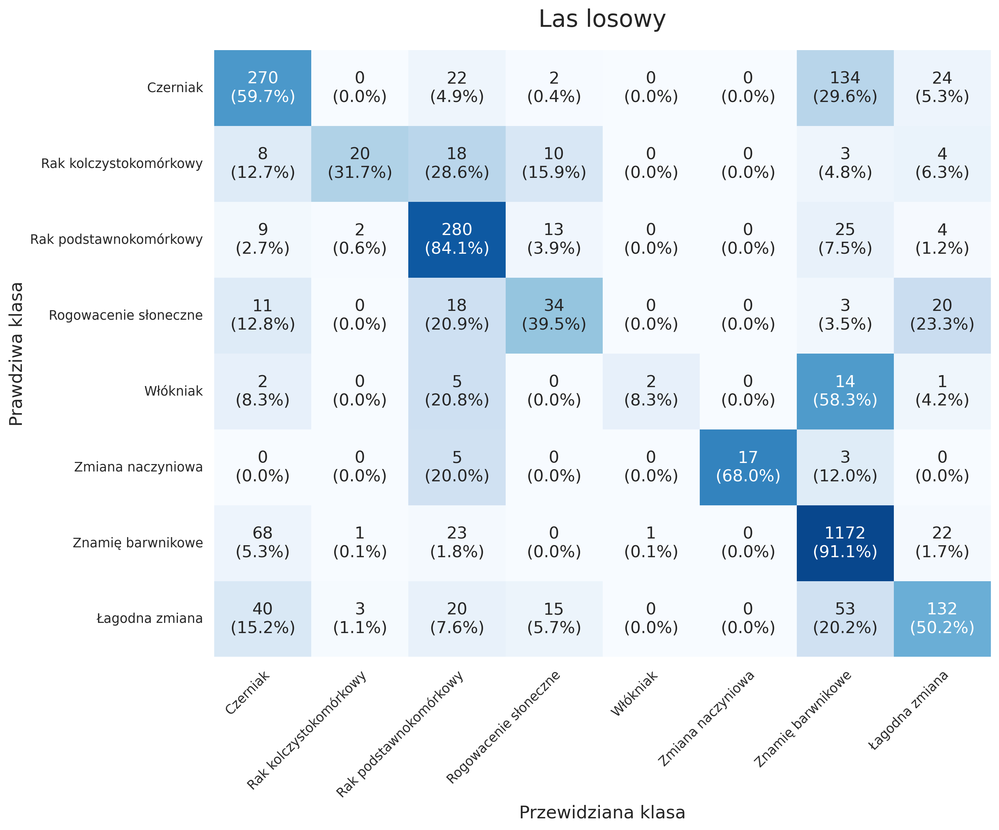

In [ ]:
models_to_compare = [MODEL_NAME, 'SVM', 'Las losowy']
plot_test_confusion_matrices(RESULTS_DIR, models_to_compare, class_names)

### Analiza generalizacji

In [ ]:
# przygotowanie wyników walidacyjnych
val_summary = df_metrics.groupby('Model')[metric_cols].mean().reset_index()
val_summary = val_summary.rename(columns={m: f"{m}_Val" for m in metric_cols})

# przygotowanie wyników testowych
test_summary = df_test[['Model'] + metric_cols].copy()
test_summary = test_summary.rename(columns={m: f"{m}_Test" for m in metric_cols})

# łączenie tabel
comparison_df = pd.merge(val_summary, test_summary, on='Model', how='inner')

# obliczanie różnic (luka generalizacji)
for m in metric_cols:
    comparison_df[f'{m}_Diff'] = comparison_df[f'{m}_Val'] - comparison_df[f'{m}_Test']

# sortujemy po różnicy w MCC
comparison_df = comparison_df.sort_values('MCC_Diff')

# zapisujemy tabelę
csv_filename = 'analiza_generalizacji.csv'
save_path = os.path.join(RESULTS_DIR, csv_filename)
df_test.to_csv(save_path, index=False)

comparison_df

,Model,MCC_Val,Czułość_Val,Specyficzność_Val,Dokładność_Val,Precyzja_Val,MCC_Test,Czułość_Test,Specyficzność_Test,Dokładność_Test,Precyzja_Test,MCC_Diff,Czułość_Diff,Specyficzność_Diff,Dokładność_Diff,Precyzja_Diff
2,SVM,0.614607,0.548475,0.953794,0.741468,0.625091,0.666822,0.568270,0.957536,0.779313,0.705450,-0.052216,-0.019794,-0.003741,-0.037845,-0.080359
1,Las losowy,0.609313,0.533834,0.953036,0.739144,0.634272,0.639190,0.540859,0.955302,0.760758,0.717987,-0.029877,-0.007026,-0.002266,-0.021614,-0.083715
0,DenseNet-121,0.575552,0.578322,0.949165,0.715326,0.543303,0.586078,0.548232,0.947024,0.727596,0.563305,-0.010526,0.030091,0.002141,-0.012270,-0.020002


In [ ]:
def plot_generalization_gap(df_val_metrics, metrics, df_test_results, save_dir=RESULTS_DIR):

    # przygotowanie wyników walidacyjnych
    val_means = df_val_metrics.groupby('Model')[metrics].mean()

    # przygotowanie wyników testowych
    test_data = df_test_results.copy()

    # jeśli 'Model' jest zwykłą kolumną (a nie indeksem), ustawiamy ją jako indeks
    if 'Model' in test_data.columns:
        test_data = test_data.set_index('Model')

    test_data.index = test_data.index.str.replace("_", " ")
    val_means.index = val_means.index.str.replace("_", " ")

    # upewniamy się, że mamy te same modele w obu tabelach (część wspólna)
    common_models = val_means.index.intersection(test_data.index)

    if len(common_models) == 0:
        print("BŁĄD: Brak wspólnych nazw modeli między walidacją a testem!")
        print(f"Modele w walidacji: {val_means.index.tolist()}")
        print(f"Modele w teście: {test_data.index.tolist()}")
        return None

    # filtrujemy dane
    val_means = val_means.loc[common_models]
    test_data = test_data.loc[common_models, metrics]

    # obliczamy różnicę (Gap = Walidacja - Test)
    # dodatnia wartość = spadek wydajności na teście
    gap_df = val_means - test_data

    # wizualizacja-

    sns.heatmap(
        gap_df,
        annot=True,
        fmt="+.4f",
        cmap="coolwarm",
        center=0,
        linewidths=.5,
        cbar_kws={'label': 'Różnica (Walidacja - Test)'}
    )

    plt.title('Analiza generalizacji modeli', pad=15)
    plt.ylabel('Model')
    plt.xlabel('Metryka')
    plt.yticks(rotation=0)

    plt.tight_layout()

    # zapisujemy wykres
    save_path = os.path.join(save_dir, "analiza_generalizacji.pdf")
    plt.savefig(save_path)
    plt.show()

    # zapisujemy tabelę
    csv_path = os.path.join(save_dir, "analiza_generalizacji.csv")
    gap_df.to_csv(csv_path, encoding='utf-8-sig')

    return gap_df

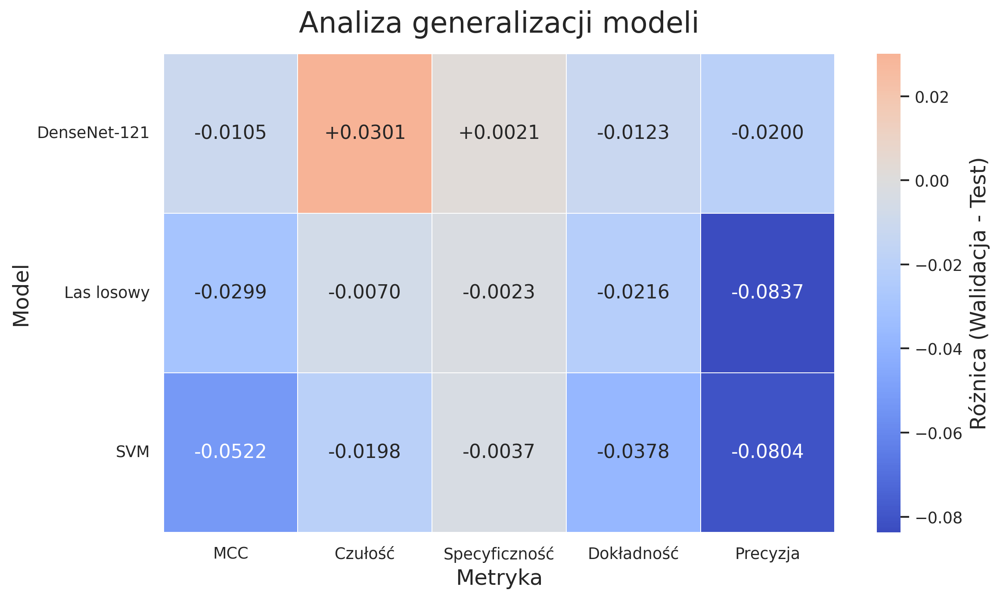

In [ ]:
df_gaps = plot_generalization_gap(df_metrics, metric_cols, df_test)

### Analiza błędów

In [ ]:
def denormalize(tensor, mean, std):
    """
    Cofnięcie procesu normalizacji na tensorze obrazu (przywrócenie oryginalnej skali kolorów).

    W uczeniu głębokim obrazy wejściowe są często standaryzowane według wzoru:
    $output = (input - mean) / std$. Funkcja ta odwraca tę operację ($output = input * std + mean$),
    co jest niezbędne do poprawnej wizualizacji obrazów, które zostały wcześniej
    przetworzone przez transformacje PyTorch (np. `transforms.Normalize`).

    Args:
        tensor (torch.Tensor): Tensor obrazu o kształcie (C, H, W).
        mean (tuple/list): Średnie użyte do normalizacji dla każdego kanału (R, G, B).
        std (tuple/list): Odchylenia standardowe użyte do normalizacji dla każdego kanału (R, G, B).

    Returns:
        torch.Tensor: Zdenormalizowany tensor gotowy do konwersji na format obrazu (np. PIL lub NumPy).
    """
    tensor = tensor.clone()
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)

    img_numpy = tensor.permute(1, 2, 0).numpy()
    img_numpy = np.clip(img_numpy, 0, 1)

    return img_numpy

In [ ]:
import matplotlib.patches as patches

def visualize_low_uncertainty_errors(model_name, results_dir, dataset, class_labels, top_n=5, save_dir=RESULTS_DIR):
    print(f"--- ANALIZA BŁĘDÓW (Niska niepewność): {model_name} ---")

    csv_path = os.path.join(results_dir, f"{model_name}_predykcje_testowe.csv")
    if not os.path.exists(csv_path):
        print(f"Błąd: Nie znaleziono pliku {csv_path}")
        return

    df = pd.read_csv(csv_path)
    errors_df = df[df['y_true'] != df['y_pred']].copy()

    if len(errors_df) == 0:
        print("Brak błędów do analizy.")
        return

    top_errors = errors_df.sort_values('niepewnosc', ascending=True).head(top_n)
    print(f"Pokazuję {len(top_errors)} pomyłek o najniższej niepewności.\n")

    # obliczamy maksymalną niepewność w tej grupie, żeby wyskalować paski
    # (żeby pasek nie był zawsze wypełniony na 100%, tylko proporcjonalnie)
    max_unc_display = top_errors['niepewnosc'].max() * 1.2
    if max_unc_display == 0: max_unc_display = 1.0 # zabezpieczenie

    for idx, row in top_errors.iterrows():
        # --- pobieranie obrazu (bez zmian) ---
        csv_img_name = str(row['id_zdjecia'])
        csv_id_clean = os.path.splitext(csv_img_name)[0]

        matches = dataset.df.index[
            dataset.df['nazwa_pliku'].astype(str).str.contains(csv_id_clean, regex=False)
        ].tolist()

        if not matches: continue
        ds_idx = matches[0]

        img_tensor, _ = dataset[ds_idx]
        img_display = denormalize(img_tensor, NORM_MEAN, NORM_STD)

        true_cls = int(row['y_true'])
        pred_cls = int(row['y_pred'])
        unc_val = row['niepewnosc']
        true_label_txt = class_labels[true_cls]
        pred_label_txt = class_labels[pred_cls]

        fig, (ax_img, ax_info) = plt.subplots(1, 2, figsize=(12, 5))

        # obraz
        ax_img.imshow(img_display)
        ax_img.axis('off')
        ax_img.set_title(f"ID: {csv_id_clean}")

        # informacja
        ax_info.axis('off')

        ax_info.set_xlim(0, 1)
        ax_info.set_ylim(0, 1)

        # tekst informacyjny
        info_text = (
            f"PRAWDA: {true_label_txt}\n"
            f"MODEL:  {pred_label_txt}\n\n"
            f"Decyzja: BŁĘDNA\n"
            f"Niepewność: {unc_val:.4f}"
        )

        ax_info.text(0.05, 0.55, info_text, fontsize=13, va='center',
                     bbox=dict(facecolor='#fff3cd', edgecolor='#e0a800', boxstyle='round,pad=1'))

        ax_info.text(0.05, 0.35, "Poziom niepewności (im mniej tym gorzej w tym wypadku):", fontsize=10, color='gray')

        rect_bg = patches.Rectangle((0.05, 0.2), 0.8, 0.08, linewidth=1, edgecolor='gray', facecolor='#f0f0f0')
        ax_info.add_patch(rect_bg)

        bar_width = (unc_val / max_unc_display) * 0.8
        rect_val = patches.Rectangle((0.05, 0.2), bar_width, 0.08, linewidth=0, facecolor='#d9534f')
        ax_info.add_patch(rect_val)

        plt.tight_layout()

        filename = f"{csv_id_clean}_True-{true_label_txt}_Pred-{pred_label_txt}.pdf"
        save_path = os.path.join(save_dir, filename)
        plt.savefig(save_path)
        plt.show()
        plt.close(fig)

--- ANALIZA BŁĘDÓW (Niska niepewność): DenseNet-121 ---
Pokazuję 5 pomyłek o najniższej niepewności.



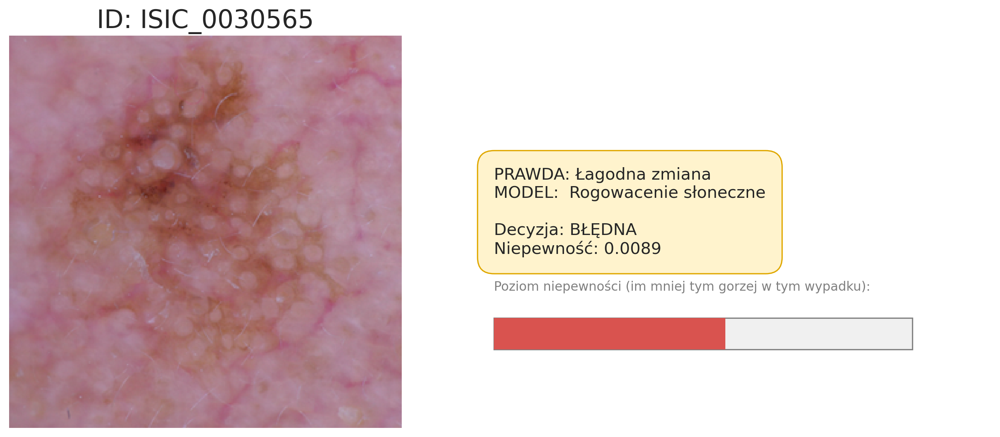

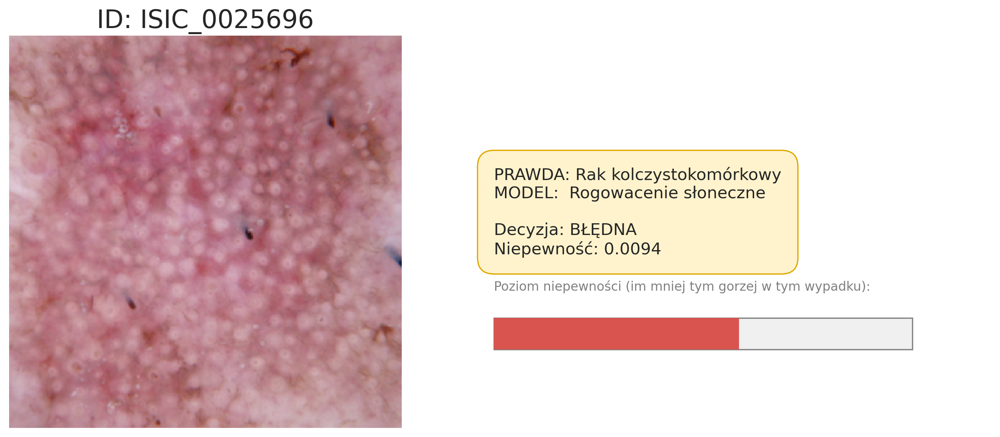

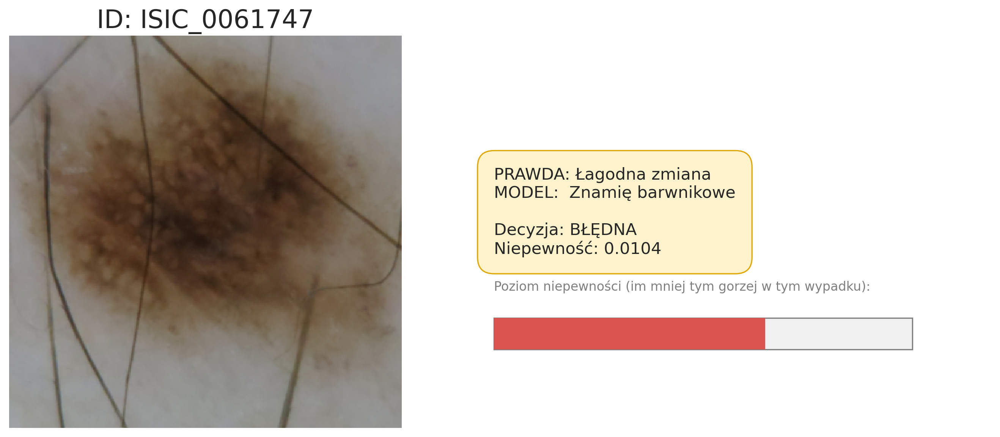

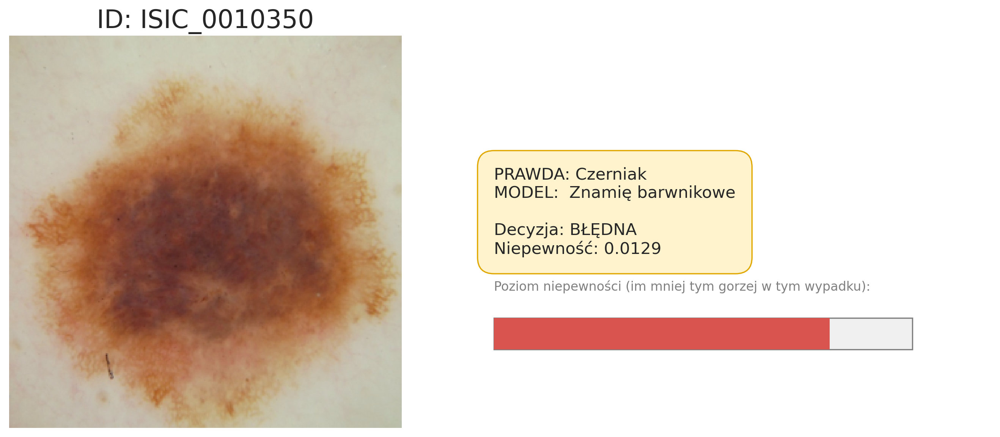

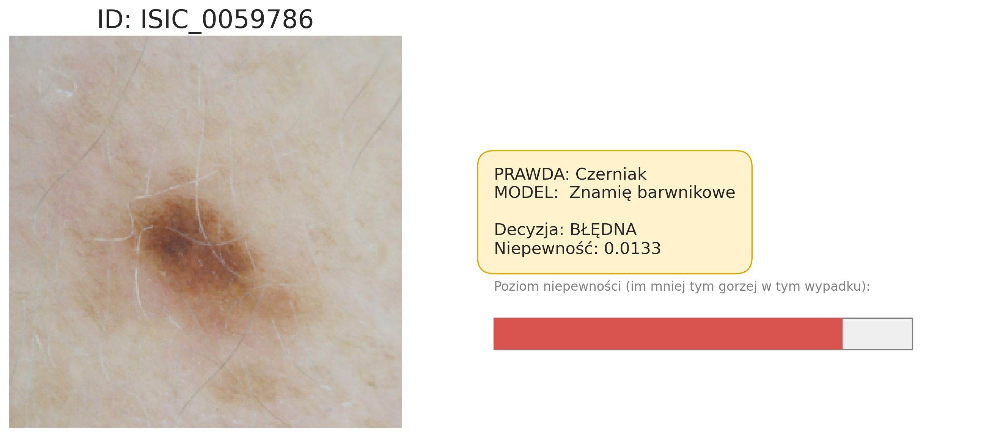

In [ ]:
visualize_low_uncertainty_errors(MODEL_NAME, RESULTS_DIR, test_dataset, class_names, top_n=5)

--- ANALIZA BŁĘDÓW (Niska niepewność): SVM ---
Pokazuję 5 pomyłek o najniższej niepewności.



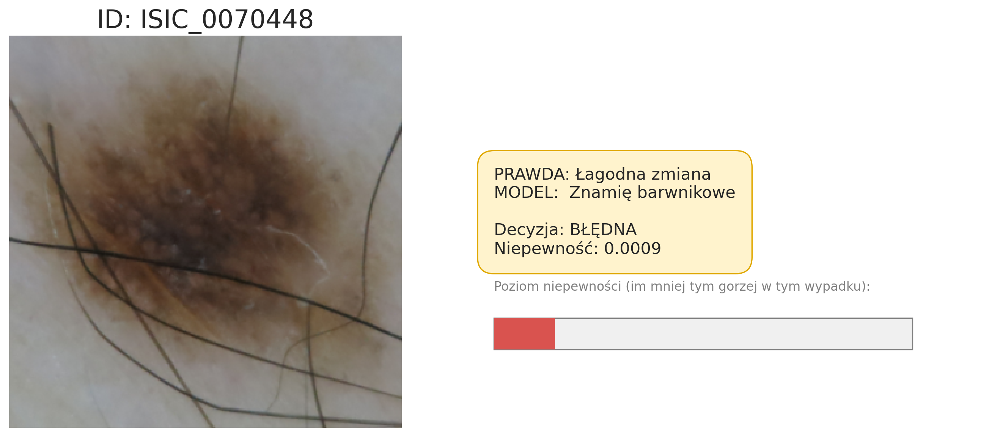

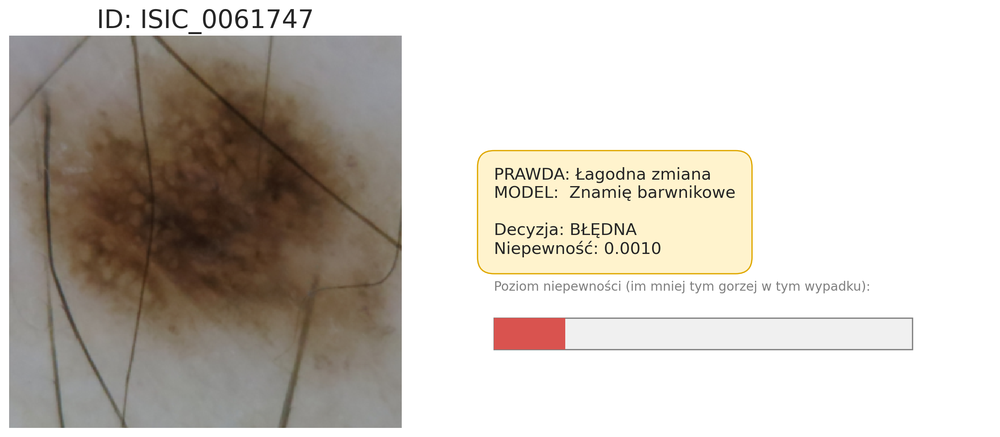

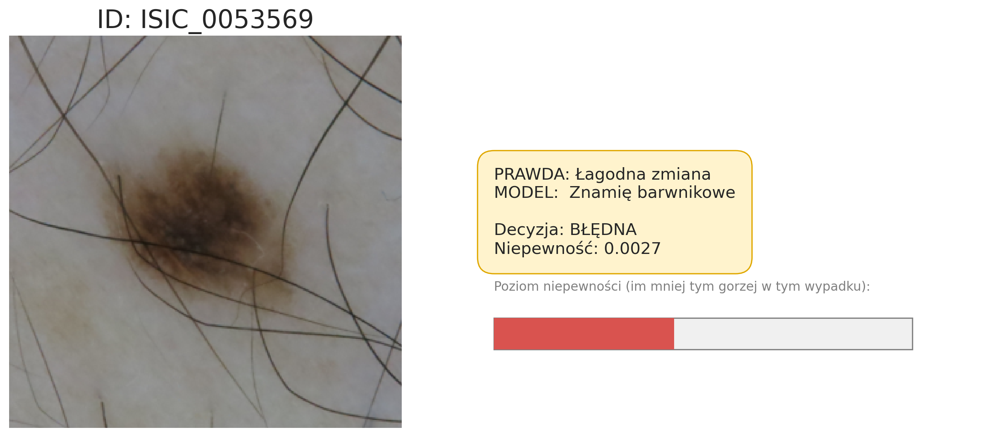

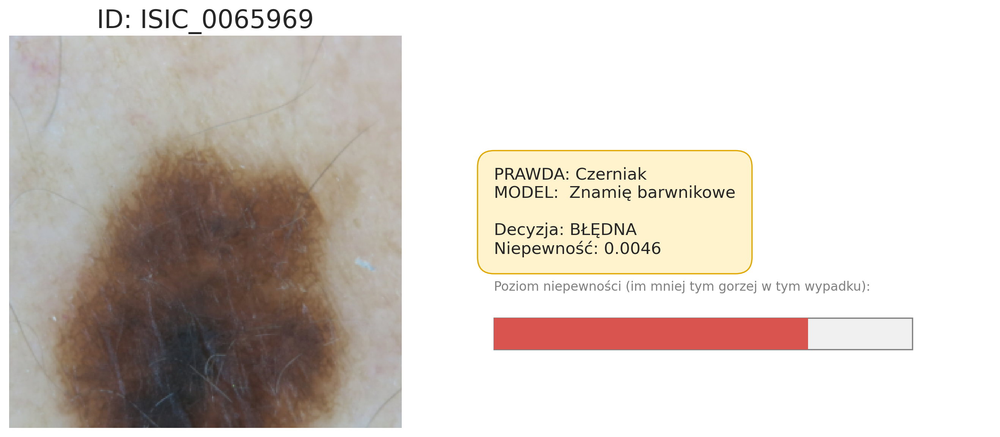

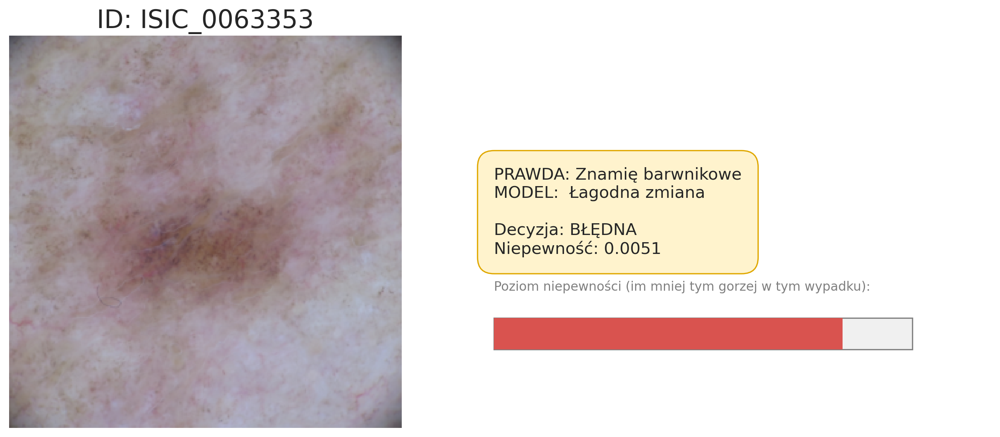

In [ ]:
visualize_low_uncertainty_errors('SVM', RESULTS_DIR, test_dataset, class_names, top_n=5)

--- ANALIZA BŁĘDÓW (Niska niepewność): Las_losowy ---
Pokazuję 5 pomyłek o najniższej niepewności.



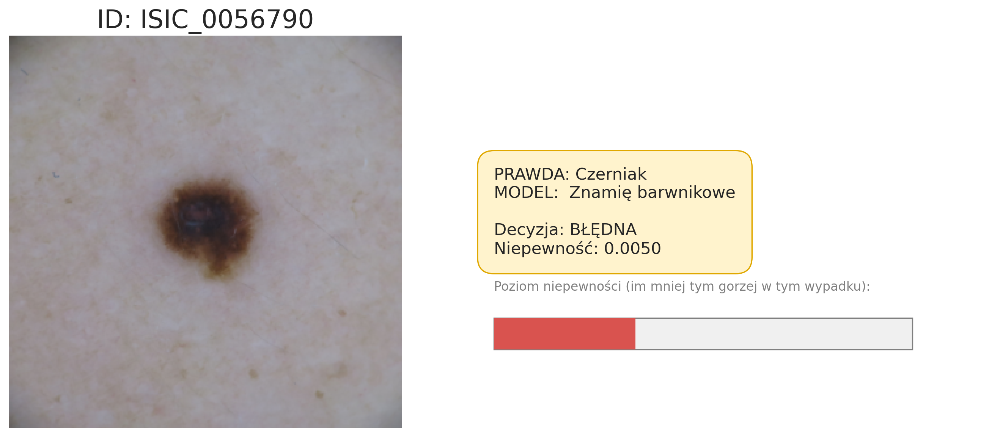

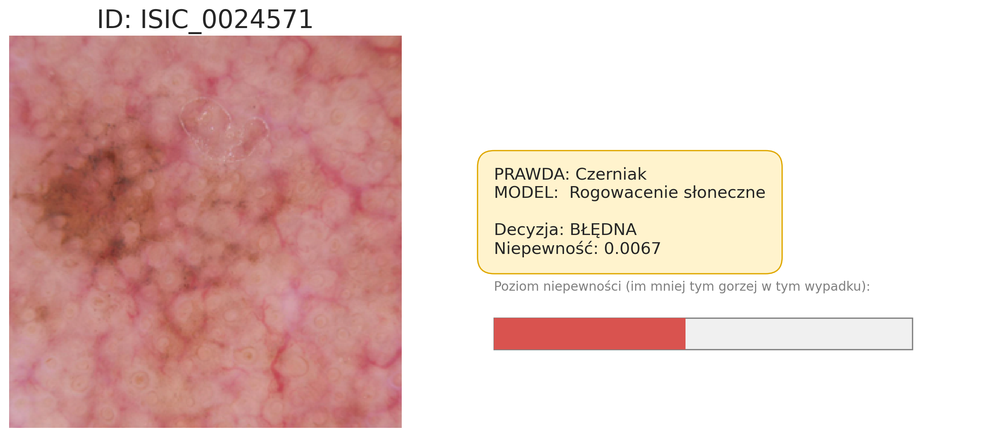

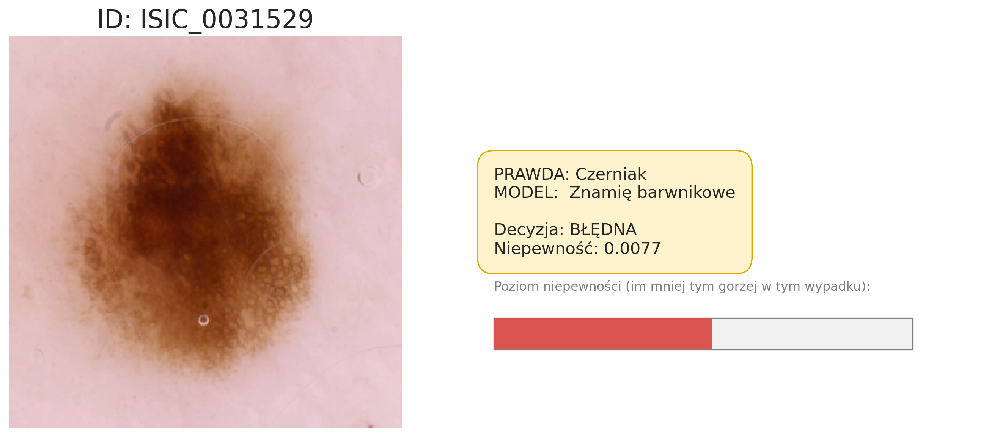

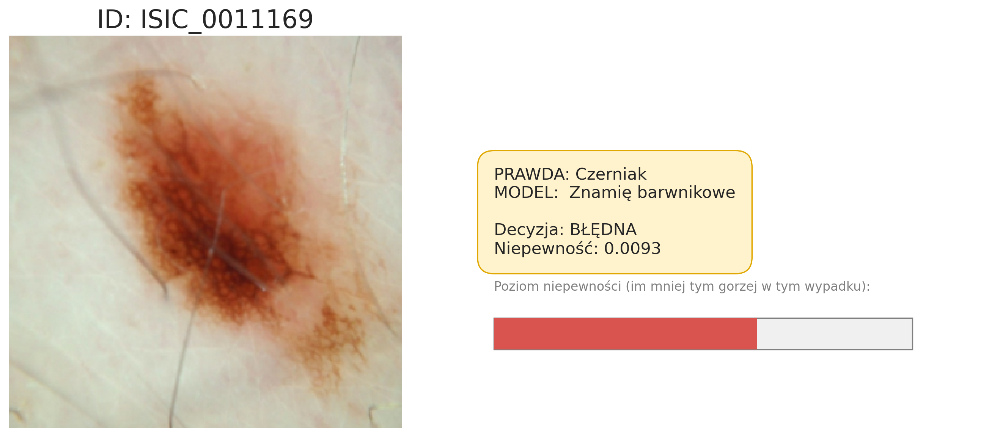

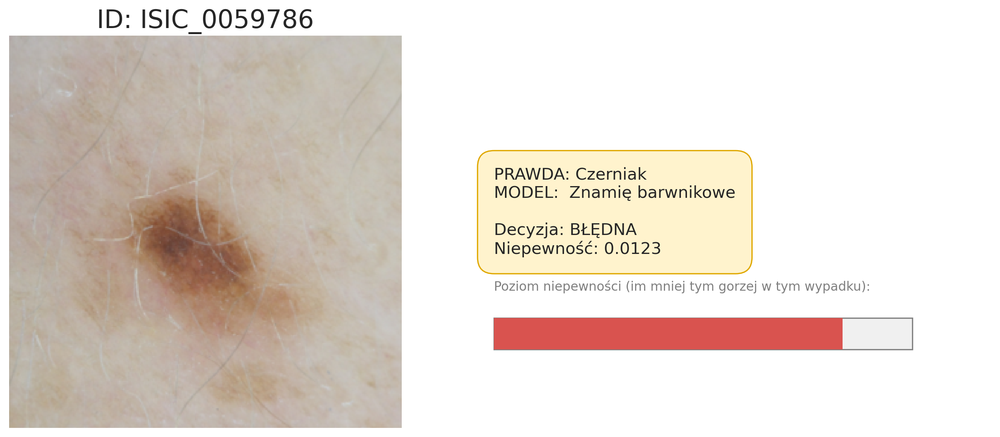

In [ ]:
visualize_low_uncertainty_errors('Las_losowy', RESULTS_DIR, test_dataset, class_names, top_n=5)

## Krzywe uczenia

In [ ]:
def load_results_from_json(filepath):
    """Wczytuje wyniki treningu z pliku JSON."""
    if os.path.exists(filepath):
        with open(filepath, 'r') as f:
            return json.load(f)
    else:
        print(f"Błąd: Nie znaleziono pliku {filepath}")
        return None

In [ ]:
def plot_training_history(cv_results, save_dir=".", filename_prefix="analiza"):
    """
    Generuje wykresy w układzie:
    Rysunek 1: Strata + MCC (metryki sterujące treningiem).
    Rysunek 2: Dokładność, Czułość, Specyficzność, Precyzja (metryki diagnostyczne).
    """

    # przetwarzanie danych
    plot_data = []
    fine_tune_start_epochs = []

    for fold_res in cv_results:
        fold_idx = fold_res['fold']
        metrics = fold_res['metryki']

        global_epoch = 0
        ft_start_found = False

        for record in metrics:
            global_epoch += 1
            stage = record.get('etap', 'nieznany')

            # wykrycie momentu dostrajania
            if stage == 'dostrajanie modelu' and not ft_start_found:
                fine_tune_start_epochs.append(global_epoch)
                ft_start_found = True

            # pobieranie danych
            loss_train = record.get('strata_treningowa', np.nan)
            loss_val = record.get('strata', np.nan)

            # dodawanie do listy (format długi dla Seaborn)
            plot_data.append({'Fold': fold_idx, 'Epoka': global_epoch, 'Wartość': loss_train, 'Metryka': 'Strata treningowa'})
            plot_data.append({'Fold': fold_idx, 'Epoka': global_epoch, 'Wartość': loss_val, 'Metryka': 'Strata walidacyjna'})

            # reszta metryk
            metric_map = {
                'mcc': 'MCC', 'dokładność': 'Dokładność',
                'czułość': 'Czułość', 'specyficzność': 'Specyficzność', 'precyzja': 'Precyzja'
            }
            for key, name in metric_map.items():
                val = record.get(key, np.nan)
                plot_data.append({'Fold': fold_idx, 'Epoka': global_epoch, 'Wartość': val, 'Metryka': name})

    df = pd.DataFrame(plot_data)
    avg_ft_start = np.mean(fine_tune_start_epochs) if fine_tune_start_epochs else None

    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    # rysowanie strata + mcc
    fig1, axes1 = plt.subplots(1, 2, figsize=(16, 6))
    fig1.suptitle('Przebieg procesu uczenia DenseNet-121', y=0.98)

    config_fig1 = [
        ('Funkcja straty', ['Strata treningowa', 'Strata walidacyjna'], None), # None = auto zakres
        ('Współczynnik korelacji Matthewsa', ['MCC'], (0.0, 1.0))
    ]

    for i, (title, metrics_to_plot, ylim) in enumerate(config_fig1):
        ax = axes1[i]
        subset = df[df['Metryka'].isin(metrics_to_plot)]

        # linie foldów (spaghetti)
        sns.lineplot(data=subset, x='Epoka', y='Wartość', hue='Metryka', units='Fold',
                     estimator=None, lw=0.8, alpha=0.25, ax=ax, legend=False, palette='tab10')
        # linia średnia
        sns.lineplot(data=subset, x='Epoka', y='Wartość', hue='Metryka',
                     lw=3, errorbar=None, ax=ax, palette='tab10')

        # linia dostrajania
        if avg_ft_start:
            ax.axvline(avg_ft_start, color='red', linestyle='--', alpha=0.7)
            if i == 0: # Podpis tylko na pierwszym
                y_txt = ax.get_ylim()[1] * 0.9 if ylim is None else subset['Wartość'].max()
                ax.text(avg_ft_start + 0.5, y_txt, 'Start dostrajania', color='red', rotation=90, va='top')

        ax.set_title(title)
        ax.set_xlabel('Epoka')
        ax.grid(True, alpha=0.3, linestyle='--')
        if ylim: ax.set_ylim(ylim)

        # legenda
        handles, labels = ax.get_legend_handles_labels()
        by_label = dict(zip(labels, handles))
        ax.legend(by_label.values(), by_label.keys(), loc='lower right')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    path1 = os.path.join(save_dir, f"{filename_prefix}_glowne.pdf")
    fig1.savefig(path1, dpi=300)
    print(f"Zapisano wykres główny: {path1}")
    plt.show()

    # rysowanie pozostałych metryk
    fig2, axes2 = plt.subplots(2, 2, figsize=(16, 12))
    fig2.suptitle('Wartości metryk w procesie treningu DenseNet-121', y=0.98)
    axes2_flat = axes2.flatten()

    config_fig2 = [
        ('Dokładność', ['Dokładność'], (0.0, 1.0)),
        ('Czułość', ['Czułość'], (0.0, 1.0)),
        ('Specyficzność', ['Specyficzność'], (0.0, 1.0)),
        ('Precyzja', ['Precyzja'], (0.0, 1.0))
    ]

    for i, (title, metrics_to_plot, ylim) in enumerate(config_fig2):
        ax = axes2_flat[i]
        subset = df[df['Metryka'].isin(metrics_to_plot)]

        sns.lineplot(data=subset, x='Epoka', y='Wartość', hue='Metryka', units='Fold',
                     estimator=None, lw=0.8, alpha=0.25, ax=ax, legend=False, palette='tab10')
        sns.lineplot(data=subset, x='Epoka', y='Wartość', hue='Metryka',
                     lw=3, errorbar=None, ax=ax, palette='tab10')

        if avg_ft_start:
            ax.axvline(avg_ft_start, color='red', linestyle='--', alpha=0.7)

        ax.set_title(title)
        ax.set_xlabel('Epoka')
        ax.grid(True, alpha=0.3, linestyle='--')
        if ylim: ax.set_ylim(ylim)

        handles, labels = ax.get_legend_handles_labels()
        by_label = dict(zip(labels, handles))
        ax.legend(by_label.values(), by_label.keys(), loc='lower right')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    path2 = os.path.join(save_dir, f"{filename_prefix}_diagnostyczne.pdf")
    fig2.savefig(path2)
    print(f"Zapisano wykres diagnostyczny: {path2}")
    plt.show()

Zapisano wykres główny: /content/drive/MyDrive/Diagnostyka raka skóry z wykorzystaniem analizy obrazów dermatologicznych/Implementacja/Wyniki/krzywe_uczenia_glowne.pdf


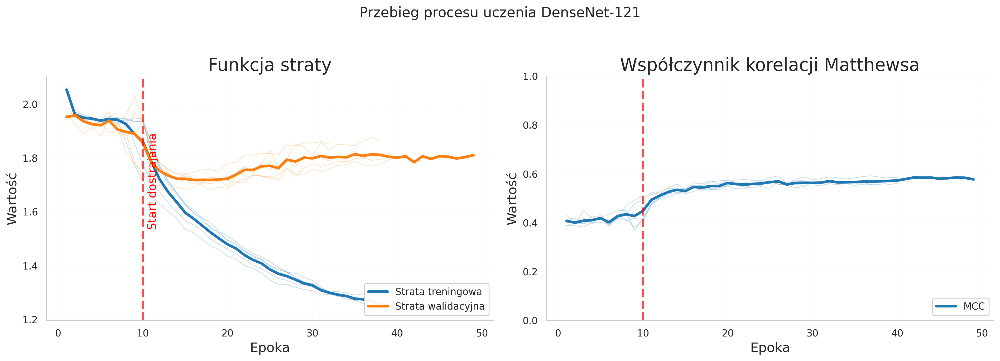

Zapisano wykres diagnostyczny: /content/drive/MyDrive/Diagnostyka raka skóry z wykorzystaniem analizy obrazów dermatologicznych/Implementacja/Wyniki/krzywe_uczenia_diagnostyczne.pdf


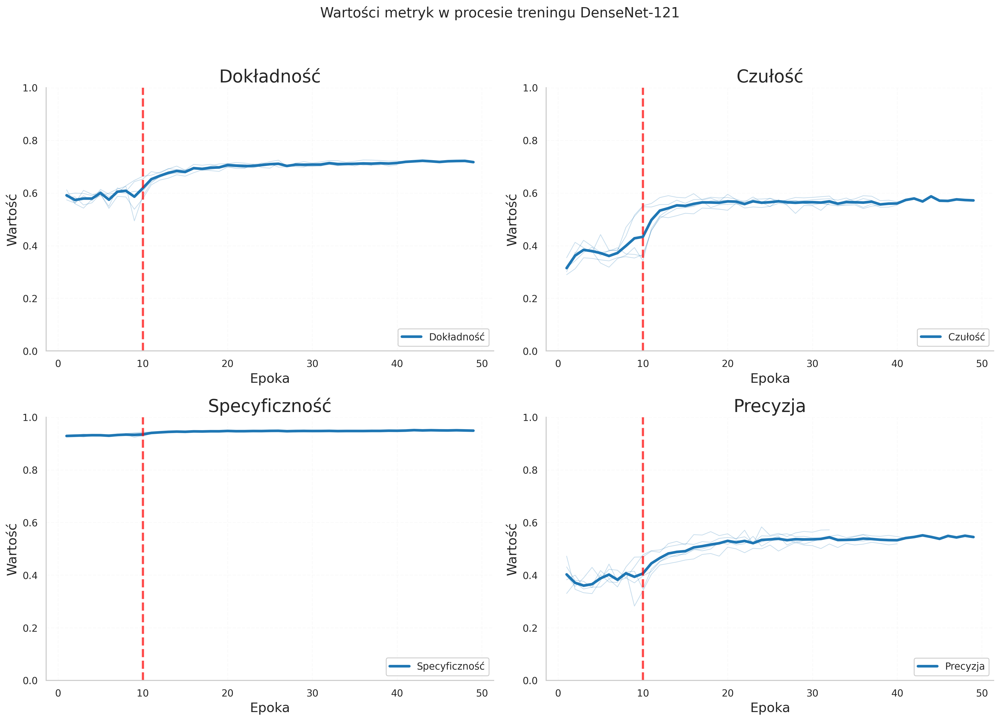

In [ ]:
filename = f'{MODEL_NAME}_wyniki_FULL.json'
cv_data = load_results_from_json(os.path.join(RESULTS_DIR, filename))
plot_training_history(cv_data, save_dir=RESULTS_DIR, filename_prefix="krzywe_uczenia")

In [ ]:
df_metadata.head()

,id_zdjecia,wiek,miejsce_zmiany,id_zmiany,plec,typ_zmiany,target,nazwa_pliku,typ_puli,nr_podzbioru
0,ISIC_0000000,55.0,Przód tułowia,ISIC_0000000,Kobieta,Znamię barwnikowe,6,ISIC_0000000.jpg,trening,3
1,ISIC_0000001,30.0,Przód tułowia,ISIC_0000001,Kobieta,Znamię barwnikowe,6,ISIC_0000001.jpg,trening,4
2,ISIC_0000002,60.0,Kończyna górna,ISIC_0000002,Kobieta,Czerniak,0,ISIC_0000002.jpg,trening,1
3,ISIC_0000003,30.0,Kończyna górna,ISIC_0000003,Mężczyzna,Znamię barwnikowe,6,ISIC_0000003.jpg,trening,2
4,ISIC_0000004,80.0,Plecy,ISIC_0000004,Mężczyzna,Czerniak,0,ISIC_0000004.jpg,trening,3


In [ ]:
def plot_disease_examples(metadata_path, images_dir, targets, save_dir=None):

    df = pd.read_csv(metadata_path)
    print(f"Wczytano metadane. Liczba wierszy: {len(df)}")

    found_images = {}

    # szukanie przykładów
    for disease_name in targets:
        # Filtrujemy po nazwie (string)
        subset = df[df['typ_zmiany'] == disease_name]

        if subset.empty:
            print(f"[OSTRZEŻENIE] Nie znaleziono w CSV żadnego wpisu dla: '{disease_name}'")
            continue

        # szukamy fizycznego pliku
        img_path = None
        for _, row in subset.iterrows():
            img_id = row['id_zdjecia']
            possible_path = os.path.join(images_dir, f"{img_id}.jpg")

            if os.path.exists(possible_path):
                img_path = possible_path
                break # znaleźliśmy pierwszy pasujący, przerywamy pętlę dla tej choroby

        if img_path:
            found_images[disease_name] = img_path
            print(f"Znaleziono przykład dla '{disease_name}': {img_id}")
        else:
            print(f"[BŁĄD] Są wpisy w CSV dla '{disease_name}', ale brakuje plików zdjęć na dysku.")

    if not found_images:
        print("Nie znaleziono żadnych zdjęć do wyświetlenia.")
        return

    # rysowanie
    n_images = len(found_images)
    fig, axes = plt.subplots(1, n_images, figsize=(5 * n_images, 5.5))
    if n_images == 1: axes = [axes]

    for ax, (name, path) in zip(axes, found_images.items()):
        # wczytanie i konwersja kolorów
        img = cv2.imread(path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        ax.imshow(img)
        # formatowanie tytułu
        title_formatted = name.capitalize()
        ax.set_title(title_formatted, pad=10)
        ax.axis('off')

    plt.tight_layout()

    # zapis
    if save_dir:
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        save_path = os.path.join(save_dir, "przyklady_nowotworow.pdf")
        plt.savefig(save_path)
        print(f"Zapisano rysunek w: {save_path}")

    plt.show()

Wczytano metadane. Liczba wierszy: 25331
Znaleziono przykład dla 'Czerniak': ISIC_0000002
Znaleziono przykład dla 'Rak podstawnokomórkowy': ISIC_0024331
Znaleziono przykład dla 'Rak kolczystokomórkowy': ISIC_0024329
Zapisano rysunek w: /content/drive/MyDrive/Diagnostyka raka skóry z wykorzystaniem analizy obrazów dermatologicznych/Implementacja/Wyniki/przyklady_nowotworow.pdf


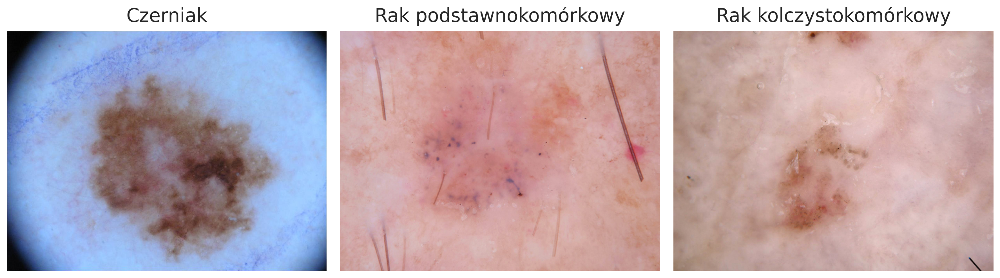

In [ ]:
plot_disease_examples(
    metadata_path=metadata_processed_path,
    images_dir=IMG_DIR,
    targets=['Czerniak', 'Rak podstawnokomórkowy', 'Rak kolczystokomórkowy'],
    save_dir=RESULTS_DIR
)